# Two-Stage Puma Classification (Flat Folder with Prefix Labels)
This notebook assumes **all images are in a single folder**.
- Filenames start with `lion` for puma images and `other` for non‑puma images.
- It automatically builds labels, detects animals with YOLOv8s, crops them, and trains an EfficientNetV2-S classifier.


In [1]:
# === Config ===
from pathlib import Path

# 👉 Set this to the folder that directly contains files like lion.001.jpg and other.001.jpg
DATA_ROOT = Path("/kaggle/input/training-data-with-redondo/trainlion_042325/trainlion_redondo")   # <-- EDIT this path

# Output/work dirs
WORK_DIR   = Path("./puma_two_stage_work")
CROPS_DIR  = WORK_DIR / "crops"
CLS_DIR    = WORK_DIR / "cls_data"
MODEL_DIR  = WORK_DIR / "models"
EVAL_DIR   = WORK_DIR / "eval"
for p in [WORK_DIR, CROPS_DIR, CLS_DIR, MODEL_DIR, EVAL_DIR]:
    p.mkdir(parents=True, exist_ok=True)

# Detector
TRAIN_DETECTOR = False
CONF_THRESH    = 0.25
IOU_THRESH     = 0.45
MAX_DETS       = 12
CROP_EXPAND    = 0.15

# Classifier
IMAGE_SIZE     = 384
VAL_SPLIT      = 0.2
SEED           = 42
BATCH_SIZE     = 32
EPOCHS_HEAD    = 4
EPOCHS_FT      = 12
UNFREEZE_LAYERS= 80
USE_FOCAL      = False

print("Config set.")

Config set.


In [2]:
# === Install dependencies (if needed) ===
%pip install -U ultralytics tensorflow scikit-learn pandas matplotlib pillow

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 0.0/1.1 MB ? eta -:--:--

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 15.1 MB/s eta 0:00:00


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.2/620.4 MB 185.1 MB/s eta 0:00:04

     ╸━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.6/620.4 MB 217.6 MB/s eta 0:00:03

     ━╸━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 25.2/620.4 MB 164.0 MB/s eta 0:00:04

     ━╸━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 30.4/620.4 MB 168.5 MB/s eta 0:00:04

     ━━╸━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.2/620.4 MB 158.5 MB/s eta 0:00:04

     ━━╸━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.2/620.4 MB 152.6 MB/s eta 0:00:04

     ━━━╺━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.1/620.4 MB 123.2 MB/s eta 0:00:05

     ━━━╸━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.8/620.4 MB 137.4 MB/s eta 0:00:05

     ━━━━╺━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.2/620.4 MB 144.4 MB/s eta 0:00:04

     ━━━━╸━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 73.9/620.4 MB 130.3 MB/s eta 0:00:05

     ━━━━━╺━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.3/620.4 MB 151.7 MB/s eta 0:00:04

     ━━━━━╸━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 90.1/620.4 MB 151.0 MB/s eta 0:00:04

     ━━━━━━╺━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.7/620.4 MB 141.6 MB/s eta 0:00:04

     ━━━━━━╺━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100.8/620.4 MB 101.6 MB/s eta 0:00:06

     ━━━━━━╸━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 113.3/620.4 MB 176.3 MB/s eta 0:00:03

     ━━━━━━╸━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.4/620.4 MB 143.8 MB/s eta 0:00:04

     ━━━━━━━╺━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 122.4/620.4 MB 134.5 MB/s eta 0:00:04

     ━━━━━━━╸━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 132.1/620.4 MB 155.5 MB/s eta 0:00:04

     ━━━━━━━━╺━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 138.4/620.4 MB 164.5 MB/s eta 0:00:03

     ━━━━━━━━╸━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 149.5/620.4 MB 157.2 MB/s eta 0:00:03

     ━━━━━━━━━╺━━━━━━━━━━━━━━━━━━━━━━━━━━━ 153.2/620.4 MB 144.3 MB/s eta 0:00:04

     ━━━━━━━━━╸━━━━━━━━━━━━━━━━━━━━━━━━━━━ 163.6/620.4 MB 155.7 MB/s eta 0:00:03

     ━━━━━━━━━━╺━━━━━━━━━━━━━━━━━━━━━━━━━━ 168.5/620.4 MB 141.8 MB/s eta 0:00:04

     ━━━━━━━━━━╸━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.5/620.4 MB 144.9 MB/s eta 0:00:04

     ━━━━━━━━━━╸━━━━━━━━━━━━━━━━━━━━━━━━━━ 183.0/620.4 MB 135.9 MB/s eta 0:00:04

     ━━━━━━━━━━━╸━━━━━━━━━━━━━━━━━━━━━━━━━ 193.9/620.4 MB 169.5 MB/s eta 0:00:03

     ━━━━━━━━━━━╸━━━━━━━━━━━━━━━━━━━━━━━━━ 198.2/620.4 MB 168.6 MB/s eta 0:00:03

     ━━━━━━━━━━━━╺━━━━━━━━━━━━━━━━━━━━━━━━ 206.6/620.4 MB 122.7 MB/s eta 0:00:04

     ━━━━━━━━━━━━╸━━━━━━━━━━━━━━━━━━━━━━━━ 210.8/620.4 MB 112.5 MB/s eta 0:00:04

     ━━━━━━━━━━━━━╺━━━━━━━━━━━━━━━━━━━━━━━ 220.2/620.4 MB 132.1 MB/s eta 0:00:04

     ━━━━━━━━━━━━━╺━━━━━━━━━━━━━━━━━━━━━━━ 226.3/620.4 MB 170.0 MB/s eta 0:00:03

     ━━━━━━━━━━━━━━╺━━━━━━━━━━━━━━━━━━━━━━ 235.3/620.4 MB 133.0 MB/s eta 0:00:03

     ━━━━━━━━━━━━━━╺━━━━━━━━━━━━━━━━━━━━━━ 241.2/620.4 MB 137.9 MB/s eta 0:00:03

     ━━━━━━━━━━━━━━╸━━━━━━━━━━━━━━━━━━━━━━ 246.4/620.4 MB 160.0 MB/s eta 0:00:03

     ━━━━━━━━━━━━━━━╺━━━━━━━━━━━━━━━━━━━━━ 257.2/620.4 MB 155.1 MB/s eta 0:00:03

     ━━━━━━━━━━━━━━━╸━━━━━━━━━━━━━━━━━━━━━ 262.5/620.4 MB 155.8 MB/s eta 0:00:03

     ━━━━━━━━━━━━━━━━╺━━━━━━━━━━━━━━━━━━━━ 271.6/620.4 MB 144.2 MB/s eta 0:00:03

     ━━━━━━━━━━━━━━━━╺━━━━━━━━━━━━━━━━━━━━ 274.6/620.4 MB 126.9 MB/s eta 0:00:03

     ━━━━━━━━━━━━━━━━╸━━━━━━━━━━━━━━━━━━━━ 278.9/620.4 MB 100.4 MB/s eta 0:00:04

     ━━━━━━━━━━━━━━━━╸━━━━━━━━━━━━━━━━━━━━ 278.9/620.4 MB 100.4 MB/s eta 0:00:04

     ━━━━━━━━━━━━━━━━━╺━━━━━━━━━━━━━━━━━━━━ 284.2/620.4 MB 51.7 MB/s eta 0:00:07

     ━━━━━━━━━━━━━━━━━╺━━━━━━━━━━━━━━━━━━━ 289.4/620.4 MB 172.9 MB/s eta 0:00:02

     ━━━━━━━━━━━━━━━━━╸━━━━━━━━━━━━━━━━━━━ 297.4/620.4 MB 113.8 MB/s eta 0:00:03

     ━━━━━━━━━━━━━━━━━╸━━━━━━━━━━━━━━━━━━━ 299.7/620.4 MB 116.6 MB/s eta 0:00:03

     ━━━━━━━━━━━━━━━━━━╺━━━━━━━━━━━━━━━━━━ 310.1/620.4 MB 152.3 MB/s eta 0:00:03

     ━━━━━━━━━━━━━━━━━━╸━━━━━━━━━━━━━━━━━━ 314.3/620.4 MB 128.1 MB/s eta 0:00:03

     ━━━━━━━━━━━━━━━━━━━╺━━━━━━━━━━━━━━━━━ 325.1/620.4 MB 159.7 MB/s eta 0:00:02

     ━━━━━━━━━━━━━━━━━━━╸━━━━━━━━━━━━━━━━━ 330.3/620.4 MB 156.3 MB/s eta 0:00:02

     ━━━━━━━━━━━━━━━━━━━━╺━━━━━━━━━━━━━━━━ 339.8/620.4 MB 140.1 MB/s eta 0:00:03

     ━━━━━━━━━━━━━━━━━━━━╸━━━━━━━━━━━━━━━━ 345.5/620.4 MB 153.9 MB/s eta 0:00:02

     ━━━━━━━━━━━━━━━━━━━━╸━━━━━━━━━━━━━━━━ 351.3/620.4 MB 162.9 MB/s eta 0:00:02

     ━━━━━━━━━━━━━━━━━━━━━╸━━━━━━━━━━━━━━━ 364.9/620.4 MB 209.6 MB/s eta 0:00:02

     ━━━━━━━━━━━━━━━━━━━━━━╺━━━━━━━━━━━━━━ 369.1/620.4 MB 160.0 MB/s eta 0:00:02

     ━━━━━━━━━━━━━━━━━━━━━━╸━━━━━━━━━━━━━━ 379.6/620.4 MB 164.9 MB/s eta 0:00:02

     ━━━━━━━━━━━━━━━━━━━━━━╸━━━━━━━━━━━━━━ 383.8/620.4 MB 128.7 MB/s eta 0:00:02

     ━━━━━━━━━━━━━━━━━━━━━━━╸━━━━━━━━━━━━━ 395.5/620.4 MB 165.9 MB/s eta 0:00:02

     ━━━━━━━━━━━━━━━━━━━━━━━╸━━━━━━━━━━━━━ 400.5/620.4 MB 195.7 MB/s eta 0:00:02

     ━━━━━━━━━━━━━━━━━━━━━━━━╺━━━━━━━━━━━━ 407.9/620.4 MB 109.2 MB/s eta 0:00:02

     ━━━━━━━━━━━━━━━━━━━━━━━━╸━━━━━━━━━━━━ 413.4/620.4 MB 143.0 MB/s eta 0:00:02

     ━━━━━━━━━━━━━━━━━━━━━━━━━╺━━━━━━━━━━━ 425.4/620.4 MB 167.4 MB/s eta 0:00:02

     ━━━━━━━━━━━━━━━━━━━━━━━━━╸━━━━━━━━━━━ 431.0/620.4 MB 168.0 MB/s eta 0:00:02

     ━━━━━━━━━━━━━━━━━━━━━━━━━━╺━━━━━━━━━━ 441.8/620.4 MB 159.6 MB/s eta 0:00:02

     ━━━━━━━━━━━━━━━━━━━━━━━━━━╸━━━━━━━━━━ 448.0/620.4 MB 162.4 MB/s eta 0:00:02

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━━━━━━━━━ 459.3/620.4 MB 168.6 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━╸━━━━━━━━━ 464.5/620.4 MB 150.2 MB/s eta 0:00:02

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━━━━━━━━ 473.2/620.4 MB 128.3 MB/s eta 0:00:02

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━━━━━━━━ 477.7/620.4 MB 130.2 MB/s eta 0:00:02

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━━━━━━━ 486.5/620.4 MB 132.7 MB/s eta 0:00:02

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━━━━━━━ 491.8/620.4 MB 153.6 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━━━━━━━ 491.8/620.4 MB 153.6 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸━━━━━━━ 501.2/620.4 MB 91.0 MB/s eta 0:00:02

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━━━━━━ 505.2/620.4 MB 133.0 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸━━━━━━ 513.2/620.4 MB 120.0 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸━━━━━━ 516.9/620.4 MB 115.7 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━━━━━ 524.3/620.4 MB 124.9 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸━━━━━ 530.1/620.4 MB 142.2 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━━━━ 541.1/620.4 MB 160.6 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸━━━━ 546.5/620.4 MB 155.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━━━ 553.6/620.4 MB 115.7 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━━━ 558.8/620.4 MB 112.3 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸━━━ 568.3/620.4 MB 154.0 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━━ 573.6/620.4 MB 153.4 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸━━ 585.1/620.4 MB 163.0 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━ 589.9/620.4 MB 145.4 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━ 594.5/620.4 MB 153.4 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺ 604.3/620.4 MB 131.0 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺ 609.2/620.4 MB 133.7 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 618.1/620.4 MB 130.5 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 620.4/620.4 MB 135.1 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 620.4/620.4 MB 823.8 kB/s eta 0:00:00


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 0.0/9.7 MB ? eta -:--:--

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╺━ 9.2/9.7 MB 134.5 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.7/9.7 MB 81.8 MB/s eta 0:00:00


     ━━━━━━━━━━━━━━━━╸━━━━━━━━━━━━━━━━━━━━━━━ 5.2/12.3 MB 195.0 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸━━━━━━━━━ 9.5/12.3 MB 136.9 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 78.1 MB/s eta 0:00:00


     ━━━━━━━━━━━━━━━━━━━╺━━━━━━━━━━━━━━━━━━━━ 4.2/8.7 MB 131.3 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 8.7/8.7 MB 134.7 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.7/8.7 MB 87.6 MB/s eta 0:00:00


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 0.0/39.7 MB ? eta -:--:--

     ━━━━╺━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/39.7 MB 126.9 MB/s eta 0:00:01

     ━━━━━━━━━━━━━╺━━━━━━━━━━━━━━━━━━━━━━━━━ 13.6/39.7 MB 122.6 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━╸━━━━━━━━━━━━━━━━━━━━ 18.9/39.7 MB 153.4 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸━━━━━━━━━━ 29.3/39.7 MB 157.8 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸━━━━━ 34.6/39.7 MB 156.3 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 39.7/39.7 MB 166.3 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 39.7/39.7 MB 166.3 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 39.7/39.7 MB 166.3 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 39.7/39.7 MB 166.3 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 39.7/39.7 MB 166.3 MB/s eta 0:00:01

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 39.7/39.7 MB 30.8 MB/s eta 0:00:00


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 0.0/5.5 MB ? eta -:--:--

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 114.0 MB/s eta 0:00:00


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 0.0/4.9 MB ? eta -:--:--

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.9/4.9 MB 78.7 MB/s eta 0:00:00


  Attempting uninstall: ml_dtypes
    Found existing installation: ml-dtypes 0.4.1
    Uninstalling ml-dtypes-0.4.1:


      Successfully uninstalled ml-dtypes-0.4.1


  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.18.0


    Uninstalling tensorboard-2.18.0:


      Successfully uninstalled tensorboard-2.18.0


  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 1.7.0


    Uninstalling scikit-learn-1.7.0:


      Successfully uninstalled scikit-learn-1.7.0


  Attempting uninstall: pandas
    Found existing installation: pandas 2.3.0


    Uninstalling pandas-2.3.0:


      Successfully uninstalled pandas-2.3.0


  Attempting uninstall: matplotlib
    Found existing installation: matplotlib 3.10.3


    Uninstalling matplotlib-3.10.3:


      Successfully uninstalled matplotlib-3.10.3


  Attempting uninstall: tensorflow
    Found existing installation: tensorflow 2.18.1


    Uninstalling tensorflow-2.18.1:


      Successfully uninstalled tensorflow-2.18.1


ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tf-keras 2.18.0 requires tensorflow<2.19,>=2.18, but you have tensorflow 2.20.0 which is incompatible.
tensorflow-tpu 2.18.0 requires ml-dtypes<0.5.0,>=0.4.0, but you have ml-dtypes 0.5.3 which is incompatible.
tensorflow-tpu 2.18.0 requires tensorboard<2.19,>=2.18, but you have tensorboard 2.20.0 which is incompatible.
tensorflow-text 2.18.1 requires tensorflow<2.19,>=2.18.0, but you have tensorflow 2.20.0 which is incompatible.



[notice] A new release of pip is available: 23.0.1 -> 25.2
[notice] To update, run: pip install --upgrade pip


Note: you may need to restart the kernel to use updated packages.


In [3]:
# === Imports & seed ===
import os, random, shutil
from pathlib import Path
import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score, precision_recall_curve, f1_score, classification_report, confusion_matrix

from ultralytics import YOLO

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.applications import efficientnet_v2

def set_seed(seed=42):
    random.seed(seed)
    np.random.seed(seed)
    tf.random.set_seed(seed)

set_seed(SEED)
print("TF:", tf.__version__)

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


TF: 2.20.0


In [4]:
# === Build labels.csv from filename prefixes ===
# We assume: filenames starting with 'lion' => label 1, anything else => label 0
CLASS_CSV = WORK_DIR / "labels.csv"
rows = []
for fn in os.listdir(DATA_ROOT):
    low = fn.lower()
    if low.endswith((".jpg",".jpeg",".png",".bmp",".gif")):
        label = 1 if low.startswith("lion") else 0
        rows.append({"filename": fn, "label": label})
pd.DataFrame(rows).to_csv(CLASS_CSV, index=False)
print(f"Wrote labels.csv with {len(rows)} entries →", CLASS_CSV)

Wrote labels.csv with 2838 entries → puma_two_stage_work/labels.csv


In [5]:
# === Detector: train or load ===
detector_weights = MODEL_DIR / "yolov8s-animal.pt"
detector_dir = DATA_ROOT / "yolo_detector"
if TRAIN_DETECTOR and (detector_dir / "images").exists() and (detector_dir / "labels").exists():
    print("Training detector on YOLO-format data...")
    yaml_path = MODEL_DIR / "detector_data.yaml"
    yaml_path.write_text(f"""
path: {detector_dir}
train: images
val: images
nc: 1
names: ['animal']
""")
    model = YOLO("yolov8s.pt")
    results = model.train(data=str(yaml_path), epochs=50, imgsz=640, batch=16, lr0=0.001,
                          optimizer='Adam', project=str(MODEL_DIR), name="detector_train", exist_ok=True)
    best = Path(results.save_dir) / "weights" / "best.pt"
    shutil.copy2(best, detector_weights)
    detector_weights = str(detector_weights)
else:
    print("Using pretrained yolov8s.pt (no fine-tuning).")
    detector_weights = "yolov8s.pt"  # ultralytics downloads automatically


Using pretrained yolov8s.pt (no fine-tuning).


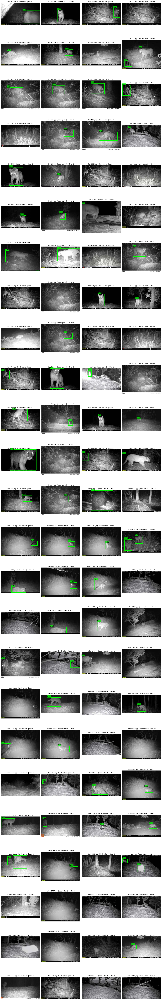

Saved audit grid to: puma_two_stage_work/eval/train_detect_audit/grid.png


In [6]:
# ==== QUICK VISUAL AUDIT OF TRAINING DETECTIONS ====
from ultralytics import YOLO
from PIL import Image
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from pathlib import Path

AUDIT_OUT = EVAL_DIR / "train_detect_audit"
AUDIT_OUT.mkdir(parents=True, exist_ok=True)

detector = YOLO(detector_weights)
df = pd.read_csv(CLASS_CSV)

# sample evenly across labels
pos = df[df.label==1].sample(min(50, (df.label==1).sum()), random_state=42)
neg = df[df.label==0].sample(min(50, (df.label==0).sum()), random_state=42)
sample = pd.concat([pos, neg]).reset_index(drop=True)

def expand_box(xyxy, expand, W, H):
    x1, y1, x2, y2 = xyxy
    w, h = x2-x1, y2-y1
    dx, dy = w*0.10, h*0.10 if 'CROP_EXPAND' not in globals() else (w*CROP_EXPAND, h*CROP_EXPAND)
    return [max(0,int(x1-dx)), max(0,int(y1-dy)), min(W-1,int(x2+dx)), min(H-1,int(y2+dy))]

ncols = 4
rows = int(np.ceil(len(sample)/ncols))
plt.figure(figsize=(4*ncols, 4*rows))

for i, row in sample.iterrows():
    fp = DATA_ROOT / row.filename
    if not fp.exists(): continue
    res = detector.predict(str(fp), imgsz=640, conf=CONF_THRESH, iou=IOU_THRESH,
                           max_det=MAX_DETS, verbose=False)
    im = Image.open(fp).convert("RGB")
    ax = plt.subplot(rows, ncols, i+1)
    ax.imshow(im); ax.axis("off")
    title = f"{fp.name}  (label={'puma' if row.label==1 else 'other'})"
    if res and res[0].boxes is not None and res[0].boxes.xyxy is not None:
        boxes = res[0].boxes.xyxy.cpu().numpy()
        confs = res[0].boxes.conf.cpu().numpy() if res[0].boxes.conf is not None else np.ones(len(boxes))
        for (x1,y1,x2,y2), p in zip(boxes, confs):
            rect = plt.Rectangle((x1,y1), x2-x1, y2-y1, fill=False, color='lime', linewidth=2)
            ax.add_patch(rect)
            ax.text(x1, max(0,y1-5), f"{p:.2f}", color='black', bbox=dict(facecolor='lime', alpha=0.7, pad=2))
        title += f"  | dets={len(boxes)}"
    else:
        title += "  | dets=0"
    ax.set_title(title, fontsize=10)

plt.tight_layout()
plt.savefig(AUDIT_OUT / "grid.png", dpi=160)
plt.show()

print("Saved audit grid to:", AUDIT_OUT / "grid.png")


In [7]:
# === Detect animals and crop ===
from ultralytics import YOLO

def expand_box(xyxy, expand, W, H):
    x1, y1, x2, y2 = xyxy
    w, h = x2 - x1, y2 - y1
    dx, dy = w*expand, h*expand
    return [max(0,int(x1-dx)), max(0,int(y1-dy)),
            min(W-1,int(x2+dx)), min(H-1,int(y2+dy))]

def crop_animals(csv_path: Path, img_dir: Path, out_dir: Path):
    out_dir.mkdir(parents=True, exist_ok=True)
    df = pd.read_csv(csv_path)
    model = YOLO(detector_weights)
    out_rows = []
    for _, row in df.iterrows():
        fp = img_dir / row['filename']
        if not fp.exists(): continue
        label = int(row['label'])
        res = model.predict(source=str(fp), imgsz=640, conf=CONF_THRESH,
                            iou=IOU_THRESH, max_det=MAX_DETS, verbose=False)
        if not res: continue
        r = res[0]
        if r.boxes is None or r.boxes.xyxy is None or len(r.boxes) == 0: continue
        im = Image.open(fp).convert("RGB")
        W,H = im.size
        for j,(x1,y1,x2,y2) in enumerate(r.boxes.xyxy.cpu().numpy()):
            x1e,y1e,x2e,y2e = expand_box([x1,y1,x2,y2], CROP_EXPAND, W, H)
            crop = im.crop((x1e,y1e,x2e,y2e))
            out_name = f"{fp.stem}_det{j}.jpg"
            crop.save(out_dir/out_name, quality=95)
            out_rows.append({"crop_file": out_name, "label": label})
    out_csv = out_dir / "crops_labels.csv"
    pd.DataFrame(out_rows).to_csv(out_csv, index=False)
    print(f"Cropped {len(out_rows)} animals →", out_csv)
    return out_csv

CROPS_CSV = crop_animals(CLASS_CSV, DATA_ROOT, CROPS_DIR)

Cropped 1994 animals → puma_two_stage_work/crops/crops_labels.csv


In [8]:
# === Build train/val classifier folders ===
def make_split(crops_csv: Path, crops_dir: Path, out_dir: Path, val_split=0.2, seed=42):
    df = pd.read_csv(crops_csv)
    X = df['crop_file'].tolist()
    y = df['label'].astype(int).values
    X_tr, X_val, y_tr, y_val = train_test_split(X, y, test_size=val_split, stratify=y, random_state=seed)
    for split in ["train","val"]:
        for cls in ["0_not_puma","1_puma"]:
            (out_dir/split/cls).mkdir(parents=True, exist_ok=True)
    def copy(files, labs, split):
        for f,l in zip(files, labs):
            src = crops_dir/f
            dst = out_dir/split/("1_puma" if l==1 else "0_not_puma")/f
            if not dst.exists(): shutil.copy2(src, dst)
    copy(X_tr, y_tr, "train")
    copy(X_val, y_val, "val")
    return out_dir/"train", out_dir/"val"

train_dir, val_dir = make_split(CROPS_CSV, CROPS_DIR, CLS_DIR, val_split=VAL_SPLIT, seed=SEED)
print("Classifier data ready:", train_dir, val_dir)

Classifier data ready: puma_two_stage_work/cls_data/train puma_two_stage_work/cls_data/val


In [9]:
# === tf.data pipeline ===
AUTO = tf.data.AUTOTUNE

def preprocess(img, label, training=True):
    img = tf.cast(img, tf.float32)
    if training:
        img = tf.image.random_brightness(img, max_delta=0.1)
        img = tf.image.random_contrast(img, 0.9, 1.1)
        img = tf.image.random_flip_left_right(img)
    return img, label

def build_ds(folder, training=True, batch_size=32):
    ds = tf.keras.utils.image_dataset_from_directory(
        folder, labels="inferred", label_mode="binary",
        image_size=(IMAGE_SIZE, IMAGE_SIZE), batch_size=None,
        shuffle=training, seed=SEED
    )
    ds = ds.map(lambda x,y: preprocess(x,y,training), num_parallel_calls=AUTO)
    if training:
        ds = ds.shuffle(1000, seed=SEED)
    return ds.batch(batch_size).prefetch(AUTO)

train_ds = build_ds(train_dir, training=True, batch_size=BATCH_SIZE)
val_ds   = build_ds(val_dir,   training=False, batch_size=BATCH_SIZE)

Found 1595 files belonging to 2 classes.


Found 399 files belonging to 2 classes.


In [10]:
# === EfficientNetV2-S model ===
base = efficientnet_v2.EfficientNetV2S(include_top=False, weights="imagenet",
                                       input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3), pooling="avg")
inputs = keras.Input(shape=(IMAGE_SIZE, IMAGE_SIZE, 3))
x = efficientnet_v2.preprocess_input(inputs)
x = base(x, training=False)
x = layers.BatchNormalization()(x)
x = layers.Dropout(0.3)(x)
x = layers.Dense(256, activation="relu")(x)
x = layers.Dropout(0.3)(x)
outputs = layers.Dense(1, activation="sigmoid")(x)
model = keras.Model(inputs, outputs)

loss_fn = keras.losses.BinaryFocalCrossentropy(gamma=2.0) if USE_FOCAL else "binary_crossentropy"
model.compile(optimizer=keras.optimizers.Adam(1e-3),
              loss=loss_fn,
              metrics=["accuracy", keras.metrics.AUC(name="auc")])
model.summary()

       0/82420632 ━━━━━━━━━━━━━━━━━━━━ 0s 0s/step

 4202496/82420632 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step

15491072/82420632 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step

25485312/82420632 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step

39297024/82420632 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step

49700864/82420632 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step

64241664/82420632 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step

77733888/82420632 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step

82420632/82420632 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 384, 384, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ efficientnetv2-s (Functional)   │ (None, 1280)           │    20,331,360 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 1280)           │         5,120 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 1280)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 256)            │       327,936 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │           257 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 20,664,673 (78.83 MB)

 Trainable params: 20,508,241 (78.23 MB)

 Non-trainable params: 156,432 (611.06 KB)

In [11]:
# === Class weights ===
def class_weights_from_dir(folder: Path):
    pos = len(list((folder / "1_puma").glob("*")))
    neg = len(list((folder / "0_not_puma").glob("*")))
    tot = pos + neg + 1e-9
    return {0: float(tot/(2*neg+1e-9)), 1: float(tot/(2*pos+1e-9))}
class_weight = class_weights_from_dir(train_dir)
print("Class weights:", class_weight)

Class weights: {0: 0.7826300294407347, 1: 1.3845486111107772}


In [12]:
# === Train head ===
callbacks = [
    keras.callbacks.EarlyStopping(monitor="val_auc", mode="max", patience=5, restore_best_weights=True),
    keras.callbacks.ReduceLROnPlateau(monitor="val_auc", mode="max", factor=0.5, patience=2, min_lr=1e-6)
]
history = model.fit(train_ds, validation_data=val_ds,
                    epochs=EPOCHS_HEAD, callbacks=callbacks,
                    class_weight=class_weight, verbose=1)

# Fine-tune
for layer in base.layers[:-UNFREEZE_LAYERS]:
    layer.trainable = False
for layer in base.layers[-UNFREEZE_LAYERS:]:
    layer.trainable = True
model.compile(optimizer=keras.optimizers.Adam(3e-5),
              loss=loss_fn,
              metrics=["accuracy", keras.metrics.AUC(name="auc")])
history_ft = model.fit(train_ds, validation_data=val_ds,
                       epochs=EPOCHS_FT, callbacks=callbacks,
                       class_weight=class_weight, verbose=1)

Epoch 1/4


 1/50 ━━━━━━━━━━━━━━━━━━━━ 47:29 58s/step - accuracy: 0.4688 - auc: 0.3684 - loss: 1.2483

 2/50 ━━━━━━━━━━━━━━━━━━━━ 7:44 10s/step - accuracy: 0.5078 - auc: 0.4560 - loss: 1.2032 

 3/50 ━━━━━━━━━━━━━━━━━━━━ 7:37 10s/step - accuracy: 0.5295 - auc: 0.5066 - loss: 1.1360

 4/50 ━━━━━━━━━━━━━━━━━━━━ 7:28 10s/step - accuracy: 0.5573 - auc: 0.5475 - loss: 1.0750

 5/50 ━━━━━━━━━━━━━━━━━━━━ 7:18 10s/step - accuracy: 0.5683 - auc: 0.5678 - loss: 1.0341

 6/50 ━━━━━━━━━━━━━━━━━━━━ 7:10 10s/step - accuracy: 0.5760 - auc: 0.5838 - loss: 1.0073

 7/50 ━━━━━━━━━━━━━━━━━━━━ 7:00 10s/step - accuracy: 0.5830 - auc: 0.5972 - loss: 0.9873

 8/50 ━━━━━━━━━━━━━━━━━━━━ 6:52 10s/step - accuracy: 0.5878 - auc: 0.6067 - loss: 0.9767

 9/50 ━━━━━━━━━━━━━━━━━━━━ 6:41 10s/step - accuracy: 0.5931 - auc: 0.6154 - loss: 0.9692

10/50 ━━━━━━━━━━━━━━━━━━━━ 6:31 10s/step - accuracy: 0.5982 - auc: 0.6234 - loss: 0.9619

11/50 ━━━━━━━━━━━━━━━━━━━━ 6:21 10s/step - accuracy: 0.6011 - auc: 0.6288 - loss: 0.9589

12/50 ━━━━━━━━━━━━━━━━━━━━ 6:10 10s/step - accuracy: 0.6035 - auc: 0.6336 - loss: 0.9572

13/50 ━━━━━━━━━━━━━━━━━━━━ 6:01 10s/step - accuracy: 0.6052 - auc: 0.6377 - loss: 0.9557

14/50 ━━━━━━━━━━━━━━━━━━━━ 5:51 10s/step - accuracy: 0.6077 - auc: 0.6422 - loss: 0.9523

15/50 ━━━━━━━━━━━━━━━━━━━━ 5:41 10s/step - accuracy: 0.6107 - auc: 0.6470 - loss: 0.9476

16/50 ━━━━━━━━━━━━━━━━━━━━ 5:32 10s/step - accuracy: 0.6136 - auc: 0.6513 - loss: 0.9432

17/50 ━━━━━━━━━━━━━━━━━━━━ 5:21 10s/step - accuracy: 0.6163 - auc: 0.6552 - loss: 0.9390

18/50 ━━━━━━━━━━━━━━━━━━━━ 5:12 10s/step - accuracy: 0.6191 - auc: 0.6593 - loss: 0.9340

19/50 ━━━━━━━━━━━━━━━━━━━━ 5:01 10s/step - accuracy: 0.6219 - auc: 0.6633 - loss: 0.9288

20/50 ━━━━━━━━━━━━━━━━━━━━ 4:52 10s/step - accuracy: 0.6246 - auc: 0.6671 - loss: 0.9246

21/50 ━━━━━━━━━━━━━━━━━━━━ 4:42 10s/step - accuracy: 0.6273 - auc: 0.6711 - loss: 0.9196

22/50 ━━━━━━━━━━━━━━━━━━━━ 4:32 10s/step - accuracy: 0.6300 - auc: 0.6749 - loss: 0.9146

23/50 ━━━━━━━━━━━━━━━━━━━━ 4:22 10s/step - accuracy: 0.6324 - auc: 0.6783 - loss: 0.9111

24/50 ━━━━━━━━━━━━━━━━━━━━ 4:12 10s/step - accuracy: 0.6346 - auc: 0.6816 - loss: 0.9082

25/50 ━━━━━━━━━━━━━━━━━━━━ 4:03 10s/step - accuracy: 0.6368 - auc: 0.6847 - loss: 0.9050

26/50 ━━━━━━━━━━━━━━━━━━━━ 3:53 10s/step - accuracy: 0.6386 - auc: 0.6875 - loss: 0.9023

27/50 ━━━━━━━━━━━━━━━━━━━━ 3:44 10s/step - accuracy: 0.6404 - auc: 0.6900 - loss: 0.9002

28/50 ━━━━━━━━━━━━━━━━━━━━ 3:34 10s/step - accuracy: 0.6423 - auc: 0.6925 - loss: 0.8978

29/50 ━━━━━━━━━━━━━━━━━━━━ 3:24 10s/step - accuracy: 0.6442 - auc: 0.6950 - loss: 0.8952

30/50 ━━━━━━━━━━━━━━━━━━━━ 3:14 10s/step - accuracy: 0.6461 - auc: 0.6976 - loss: 0.8925

31/50 ━━━━━━━━━━━━━━━━━━━━ 3:04 10s/step - accuracy: 0.6479 - auc: 0.7000 - loss: 0.8903

32/50 ━━━━━━━━━━━━━━━━━━━━ 2:55 10s/step - accuracy: 0.6498 - auc: 0.7024 - loss: 0.8882

33/50 ━━━━━━━━━━━━━━━━━━━━ 2:45 10s/step - accuracy: 0.6516 - auc: 0.7046 - loss: 0.8861

34/50 ━━━━━━━━━━━━━━━━━━━━ 2:35 10s/step - accuracy: 0.6532 - auc: 0.7067 - loss: 0.8843

35/50 ━━━━━━━━━━━━━━━━━━━━ 2:25 10s/step - accuracy: 0.6548 - auc: 0.7087 - loss: 0.8824

36/50 ━━━━━━━━━━━━━━━━━━━━ 2:16 10s/step - accuracy: 0.6563 - auc: 0.7106 - loss: 0.8804

37/50 ━━━━━━━━━━━━━━━━━━━━ 2:06 10s/step - accuracy: 0.6577 - auc: 0.7124 - loss: 0.8785

38/50 ━━━━━━━━━━━━━━━━━━━━ 1:56 10s/step - accuracy: 0.6591 - auc: 0.7141 - loss: 0.8765

39/50 ━━━━━━━━━━━━━━━━━━━━ 1:46 10s/step - accuracy: 0.6605 - auc: 0.7157 - loss: 0.8746

40/50 ━━━━━━━━━━━━━━━━━━━━ 1:37 10s/step - accuracy: 0.6618 - auc: 0.7173 - loss: 0.8725

41/50 ━━━━━━━━━━━━━━━━━━━━ 1:27 10s/step - accuracy: 0.6632 - auc: 0.7189 - loss: 0.8704

42/50 ━━━━━━━━━━━━━━━━━━━━ 1:17 10s/step - accuracy: 0.6645 - auc: 0.7204 - loss: 0.8682

43/50 ━━━━━━━━━━━━━━━━━━━━ 1:08 10s/step - accuracy: 0.6658 - auc: 0.7219 - loss: 0.8660

44/50 ━━━━━━━━━━━━━━━━━━━━ 58s 10s/step - accuracy: 0.6671 - auc: 0.7234 - loss: 0.8638 

45/50 ━━━━━━━━━━━━━━━━━━━━ 48s 10s/step - accuracy: 0.6683 - auc: 0.7248 - loss: 0.8616

46/50 ━━━━━━━━━━━━━━━━━━━━ 38s 10s/step - accuracy: 0.6695 - auc: 0.7262 - loss: 0.8595

47/50 ━━━━━━━━━━━━━━━━━━━━ 29s 10s/step - accuracy: 0.6706 - auc: 0.7275 - loss: 0.8574

48/50 ━━━━━━━━━━━━━━━━━━━━ 19s 10s/step - accuracy: 0.6717 - auc: 0.7288 - loss: 0.8552

49/50 ━━━━━━━━━━━━━━━━━━━━ 9s 10s/step - accuracy: 0.6728 - auc: 0.7301 - loss: 0.8530 

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10s/step - accuracy: 0.6738 - auc: 0.7313 - loss: 0.8510

50/50 ━━━━━━━━━━━━━━━━━━━━ 554s 10s/step - accuracy: 0.6748 - auc: 0.7325 - loss: 0.8490 - val_accuracy: 0.8521 - val_auc: 0.9356 - val_loss: 0.3505 - learning_rate: 0.0010


Epoch 2/4


 1/50 ━━━━━━━━━━━━━━━━━━━━ 8:00 10s/step - accuracy: 0.6562 - auc: 0.8000 - loss: 0.7162

 2/50 ━━━━━━━━━━━━━━━━━━━━ 7:28 9s/step - accuracy: 0.7188 - auc: 0.8360 - loss: 0.6248 

 3/50 ━━━━━━━━━━━━━━━━━━━━ 7:20 9s/step - accuracy: 0.7500 - auc: 0.8500 - loss: 0.5754

 4/50 ━━━━━━━━━━━━━━━━━━━━ 7:14 9s/step - accuracy: 0.7695 - auc: 0.8592 - loss: 0.5500

 5/50 ━━━━━━━━━━━━━━━━━━━━ 7:05 9s/step - accuracy: 0.7819 - auc: 0.8672 - loss: 0.5270

 6/50 ━━━━━━━━━━━━━━━━━━━━ 6:55 9s/step - accuracy: 0.7896 - auc: 0.8731 - loss: 0.5083

 7/50 ━━━━━━━━━━━━━━━━━━━━ 6:47 9s/step - accuracy: 0.7929 - auc: 0.8764 - loss: 0.4965

 8/50 ━━━━━━━━━━━━━━━━━━━━ 6:38 9s/step - accuracy: 0.7948 - auc: 0.8791 - loss: 0.4867

 9/50 ━━━━━━━━━━━━━━━━━━━━ 6:30 10s/step - accuracy: 0.7960 - auc: 0.8803 - loss: 0.4871

10/50 ━━━━━━━━━━━━━━━━━━━━ 6:20 10s/step - accuracy: 0.7980 - auc: 0.8820 - loss: 0.4850

11/50 ━━━━━━━━━━━━━━━━━━━━ 6:11 10s/step - accuracy: 0.8001 - auc: 0.8838 - loss: 0.4813

12/50 ━━━━━━━━━━━━━━━━━━━━ 6:02 10s/step - accuracy: 0.8022 - auc: 0.8859 - loss: 0.4768

13/50 ━━━━━━━━━━━━━━━━━━━━ 5:52 10s/step - accuracy: 0.8045 - auc: 0.8880 - loss: 0.4716

14/50 ━━━━━━━━━━━━━━━━━━━━ 5:43 10s/step - accuracy: 0.8068 - auc: 0.8901 - loss: 0.4662

15/50 ━━━━━━━━━━━━━━━━━━━━ 5:35 10s/step - accuracy: 0.8088 - auc: 0.8921 - loss: 0.4609

16/50 ━━━━━━━━━━━━━━━━━━━━ 5:25 10s/step - accuracy: 0.8109 - auc: 0.8939 - loss: 0.4563

17/50 ━━━━━━━━━━━━━━━━━━━━ 5:16 10s/step - accuracy: 0.8128 - auc: 0.8952 - loss: 0.4531

18/50 ━━━━━━━━━━━━━━━━━━━━ 5:06 10s/step - accuracy: 0.8150 - auc: 0.8968 - loss: 0.4492

19/50 ━━━━━━━━━━━━━━━━━━━━ 4:57 10s/step - accuracy: 0.8171 - auc: 0.8981 - loss: 0.4459

20/50 ━━━━━━━━━━━━━━━━━━━━ 4:47 10s/step - accuracy: 0.8193 - auc: 0.8997 - loss: 0.4421

21/50 ━━━━━━━━━━━━━━━━━━━━ 4:37 10s/step - accuracy: 0.8213 - auc: 0.9011 - loss: 0.4385

22/50 ━━━━━━━━━━━━━━━━━━━━ 4:28 10s/step - accuracy: 0.8230 - auc: 0.9022 - loss: 0.4375

23/50 ━━━━━━━━━━━━━━━━━━━━ 4:18 10s/step - accuracy: 0.8246 - auc: 0.9030 - loss: 0.4369

24/50 ━━━━━━━━━━━━━━━━━━━━ 4:09 10s/step - accuracy: 0.8261 - auc: 0.9039 - loss: 0.4361

25/50 ━━━━━━━━━━━━━━━━━━━━ 4:00 10s/step - accuracy: 0.8275 - auc: 0.9047 - loss: 0.4353

26/50 ━━━━━━━━━━━━━━━━━━━━ 3:50 10s/step - accuracy: 0.8286 - auc: 0.9052 - loss: 0.4355

27/50 ━━━━━━━━━━━━━━━━━━━━ 3:41 10s/step - accuracy: 0.8296 - auc: 0.9056 - loss: 0.4358

28/50 ━━━━━━━━━━━━━━━━━━━━ 3:31 10s/step - accuracy: 0.8305 - auc: 0.9060 - loss: 0.4360

29/50 ━━━━━━━━━━━━━━━━━━━━ 3:22 10s/step - accuracy: 0.8311 - auc: 0.9063 - loss: 0.4379

30/50 ━━━━━━━━━━━━━━━━━━━━ 3:12 10s/step - accuracy: 0.8317 - auc: 0.9066 - loss: 0.4408

31/50 ━━━━━━━━━━━━━━━━━━━━ 3:03 10s/step - accuracy: 0.8323 - auc: 0.9069 - loss: 0.4433

32/50 ━━━━━━━━━━━━━━━━━━━━ 2:53 10s/step - accuracy: 0.8326 - auc: 0.9070 - loss: 0.4462

33/50 ━━━━━━━━━━━━━━━━━━━━ 2:43 10s/step - accuracy: 0.8329 - auc: 0.9071 - loss: 0.4488

34/50 ━━━━━━━━━━━━━━━━━━━━ 2:34 10s/step - accuracy: 0.8331 - auc: 0.9072 - loss: 0.4511

35/50 ━━━━━━━━━━━━━━━━━━━━ 2:24 10s/step - accuracy: 0.8332 - auc: 0.9072 - loss: 0.4536

36/50 ━━━━━━━━━━━━━━━━━━━━ 2:15 10s/step - accuracy: 0.8333 - auc: 0.9072 - loss: 0.4560

37/50 ━━━━━━━━━━━━━━━━━━━━ 2:05 10s/step - accuracy: 0.8333 - auc: 0.9071 - loss: 0.4585

38/50 ━━━━━━━━━━━━━━━━━━━━ 1:55 10s/step - accuracy: 0.8334 - auc: 0.9070 - loss: 0.4607

39/50 ━━━━━━━━━━━━━━━━━━━━ 1:46 10s/step - accuracy: 0.8334 - auc: 0.9069 - loss: 0.4627

40/50 ━━━━━━━━━━━━━━━━━━━━ 1:36 10s/step - accuracy: 0.8334 - auc: 0.9068 - loss: 0.4646

41/50 ━━━━━━━━━━━━━━━━━━━━ 1:26 10s/step - accuracy: 0.8334 - auc: 0.9067 - loss: 0.4668

42/50 ━━━━━━━━━━━━━━━━━━━━ 1:17 10s/step - accuracy: 0.8334 - auc: 0.9066 - loss: 0.4688

43/50 ━━━━━━━━━━━━━━━━━━━━ 1:07 10s/step - accuracy: 0.8334 - auc: 0.9064 - loss: 0.4707

44/50 ━━━━━━━━━━━━━━━━━━━━ 58s 10s/step - accuracy: 0.8334 - auc: 0.9062 - loss: 0.4727 

45/50 ━━━━━━━━━━━━━━━━━━━━ 48s 10s/step - accuracy: 0.8333 - auc: 0.9060 - loss: 0.4746

46/50 ━━━━━━━━━━━━━━━━━━━━ 38s 10s/step - accuracy: 0.8332 - auc: 0.9058 - loss: 0.4763

47/50 ━━━━━━━━━━━━━━━━━━━━ 29s 10s/step - accuracy: 0.8331 - auc: 0.9056 - loss: 0.4779

48/50 ━━━━━━━━━━━━━━━━━━━━ 19s 10s/step - accuracy: 0.8330 - auc: 0.9054 - loss: 0.4794

49/50 ━━━━━━━━━━━━━━━━━━━━ 9s 10s/step - accuracy: 0.8328 - auc: 0.9052 - loss: 0.4808 

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 10s/step - accuracy: 0.8327 - auc: 0.9050 - loss: 0.4821

50/50 ━━━━━━━━━━━━━━━━━━━━ 501s 10s/step - accuracy: 0.8326 - auc: 0.9048 - loss: 0.4834 - val_accuracy: 0.8170 - val_auc: 0.8842 - val_loss: 1.5639 - learning_rate: 0.0010


Epoch 3/4


 1/50 ━━━━━━━━━━━━━━━━━━━━ 8:00 10s/step - accuracy: 0.8125 - auc: 0.8766 - loss: 0.5001

 2/50 ━━━━━━━━━━━━━━━━━━━━ 7:49 10s/step - accuracy: 0.8047 - auc: 0.8724 - loss: 0.5944

 3/50 ━━━━━━━━━━━━━━━━━━━━ 7:28 10s/step - accuracy: 0.8003 - auc: 0.8639 - loss: 0.6345

 4/50 ━━━━━━━━━━━━━━━━━━━━ 7:19 10s/step - accuracy: 0.7995 - auc: 0.8624 - loss: 0.6393

 5/50 ━━━━━━━━━━━━━━━━━━━━ 7:11 10s/step - accuracy: 0.7946 - auc: 0.8613 - loss: 0.6367

 6/50 ━━━━━━━━━━━━━━━━━━━━ 7:01 10s/step - accuracy: 0.7915 - auc: 0.8606 - loss: 0.6290

 7/50 ━━━━━━━━━━━━━━━━━━━━ 6:51 10s/step - accuracy: 0.7881 - auc: 0.8589 - loss: 0.6225

 8/50 ━━━━━━━━━━━━━━━━━━━━ 6:41 10s/step - accuracy: 0.7873 - auc: 0.8593 - loss: 0.6128

 9/50 ━━━━━━━━━━━━━━━━━━━━ 6:31 10s/step - accuracy: 0.7850 - auc: 0.8586 - loss: 0.6148

10/50 ━━━━━━━━━━━━━━━━━━━━ 6:22 10s/step - accuracy: 0.7831 - auc: 0.8582 - loss: 0.6147

11/50 ━━━━━━━━━━━━━━━━━━━━ 6:12 10s/step - accuracy: 0.7819 - auc: 0.8583 - loss: 0.6128

12/50 ━━━━━━━━━━━━━━━━━━━━ 6:03 10s/step - accuracy: 0.7816 - auc: 0.8590 - loss: 0.6095

13/50 ━━━━━━━━━━━━━━━━━━━━ 5:53 10s/step - accuracy: 0.7814 - auc: 0.8596 - loss: 0.6068

14/50 ━━━━━━━━━━━━━━━━━━━━ 5:43 10s/step - accuracy: 0.7809 - auc: 0.8598 - loss: 0.6055

15/50 ━━━━━━━━━━━━━━━━━━━━ 5:34 10s/step - accuracy: 0.7805 - auc: 0.8598 - loss: 0.6062

16/50 ━━━━━━━━━━━━━━━━━━━━ 5:24 10s/step - accuracy: 0.7809 - auc: 0.8604 - loss: 0.6048

17/50 ━━━━━━━━━━━━━━━━━━━━ 5:14 10s/step - accuracy: 0.7813 - auc: 0.8610 - loss: 0.6031

18/50 ━━━━━━━━━━━━━━━━━━━━ 5:04 10s/step - accuracy: 0.7815 - auc: 0.8613 - loss: 0.6017

19/50 ━━━━━━━━━━━━━━━━━━━━ 4:55 10s/step - accuracy: 0.7818 - auc: 0.8617 - loss: 0.6002

20/50 ━━━━━━━━━━━━━━━━━━━━ 4:45 10s/step - accuracy: 0.7822 - auc: 0.8620 - loss: 0.5989

21/50 ━━━━━━━━━━━━━━━━━━━━ 4:36 10s/step - accuracy: 0.7827 - auc: 0.8623 - loss: 0.5976

22/50 ━━━━━━━━━━━━━━━━━━━━ 4:26 10s/step - accuracy: 0.7835 - auc: 0.8628 - loss: 0.5956

23/50 ━━━━━━━━━━━━━━━━━━━━ 4:17 10s/step - accuracy: 0.7842 - auc: 0.8634 - loss: 0.5934

24/50 ━━━━━━━━━━━━━━━━━━━━ 4:08 10s/step - accuracy: 0.7851 - auc: 0.8641 - loss: 0.5927

25/50 ━━━━━━━━━━━━━━━━━━━━ 3:58 10s/step - accuracy: 0.7862 - auc: 0.8648 - loss: 0.5939

26/50 ━━━━━━━━━━━━━━━━━━━━ 3:49 10s/step - accuracy: 0.7874 - auc: 0.8657 - loss: 0.5944

27/50 ━━━━━━━━━━━━━━━━━━━━ 3:39 10s/step - accuracy: 0.7886 - auc: 0.8666 - loss: 0.5944

28/50 ━━━━━━━━━━━━━━━━━━━━ 3:30 10s/step - accuracy: 0.7897 - auc: 0.8674 - loss: 0.5949

29/50 ━━━━━━━━━━━━━━━━━━━━ 3:20 10s/step - accuracy: 0.7907 - auc: 0.8681 - loss: 0.5950

30/50 ━━━━━━━━━━━━━━━━━━━━ 3:10 10s/step - accuracy: 0.7916 - auc: 0.8688 - loss: 0.5953

31/50 ━━━━━━━━━━━━━━━━━━━━ 3:01 10s/step - accuracy: 0.7924 - auc: 0.8695 - loss: 0.5953

32/50 ━━━━━━━━━━━━━━━━━━━━ 2:51 10s/step - accuracy: 0.7933 - auc: 0.8701 - loss: 0.5952

33/50 ━━━━━━━━━━━━━━━━━━━━ 2:42 10s/step - accuracy: 0.7941 - auc: 0.8708 - loss: 0.5948

34/50 ━━━━━━━━━━━━━━━━━━━━ 2:32 10s/step - accuracy: 0.7948 - auc: 0.8715 - loss: 0.5943

35/50 ━━━━━━━━━━━━━━━━━━━━ 2:23 10s/step - accuracy: 0.7956 - auc: 0.8721 - loss: 0.5938

36/50 ━━━━━━━━━━━━━━━━━━━━ 2:13 10s/step - accuracy: 0.7963 - auc: 0.8726 - loss: 0.5934

37/50 ━━━━━━━━━━━━━━━━━━━━ 2:04 10s/step - accuracy: 0.7969 - auc: 0.8731 - loss: 0.5935

38/50 ━━━━━━━━━━━━━━━━━━━━ 1:54 10s/step - accuracy: 0.7974 - auc: 0.8734 - loss: 0.5943

39/50 ━━━━━━━━━━━━━━━━━━━━ 1:44 10s/step - accuracy: 0.7979 - auc: 0.8737 - loss: 0.5950

40/50 ━━━━━━━━━━━━━━━━━━━━ 1:35 10s/step - accuracy: 0.7984 - auc: 0.8741 - loss: 0.5957

41/50 ━━━━━━━━━━━━━━━━━━━━ 1:25 10s/step - accuracy: 0.7988 - auc: 0.8744 - loss: 0.5963

42/50 ━━━━━━━━━━━━━━━━━━━━ 1:16 10s/step - accuracy: 0.7991 - auc: 0.8747 - loss: 0.5967

43/50 ━━━━━━━━━━━━━━━━━━━━ 1:06 10s/step - accuracy: 0.7994 - auc: 0.8749 - loss: 0.5989

44/50 ━━━━━━━━━━━━━━━━━━━━ 57s 10s/step - accuracy: 0.7997 - auc: 0.8751 - loss: 0.6008 

45/50 ━━━━━━━━━━━━━━━━━━━━ 47s 10s/step - accuracy: 0.8000 - auc: 0.8753 - loss: 0.6025

46/50 ━━━━━━━━━━━━━━━━━━━━ 38s 10s/step - accuracy: 0.8002 - auc: 0.8754 - loss: 0.6041

47/50 ━━━━━━━━━━━━━━━━━━━━ 28s 10s/step - accuracy: 0.8004 - auc: 0.8756 - loss: 0.6056

48/50 ━━━━━━━━━━━━━━━━━━━━ 19s 10s/step - accuracy: 0.8006 - auc: 0.8756 - loss: 0.6077

49/50 ━━━━━━━━━━━━━━━━━━━━ 9s 10s/step - accuracy: 0.8008 - auc: 0.8757 - loss: 0.6095 

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 9s/step - accuracy: 0.8010 - auc: 0.8758 - loss: 0.6112 

50/50 ━━━━━━━━━━━━━━━━━━━━ 493s 10s/step - accuracy: 0.8012 - auc: 0.8759 - loss: 0.6129 - val_accuracy: 0.6742 - val_auc: 0.7421 - val_loss: 0.6241 - learning_rate: 0.0010


Epoch 4/4


 1/50 ━━━━━━━━━━━━━━━━━━━━ 7:55 10s/step - accuracy: 0.8125 - auc: 0.9255 - loss: 0.4704

 2/50 ━━━━━━━━━━━━━━━━━━━━ 7:33 9s/step - accuracy: 0.8438 - auc: 0.9262 - loss: 0.4898 

 3/50 ━━━━━━━━━━━━━━━━━━━━ 7:24 9s/step - accuracy: 0.8576 - auc: 0.9266 - loss: 0.4745

 4/50 ━━━━━━━━━━━━━━━━━━━━ 7:15 9s/step - accuracy: 0.8581 - auc: 0.9240 - loss: 0.4641

 5/50 ━━━━━━━━━━━━━━━━━━━━ 7:05 9s/step - accuracy: 0.8602 - auc: 0.9236 - loss: 0.4541

 6/50 ━━━━━━━━━━━━━━━━━━━━ 6:55 9s/step - accuracy: 0.8609 - auc: 0.9237 - loss: 0.4454

 7/50 ━━━━━━━━━━━━━━━━━━━━ 6:45 9s/step - accuracy: 0.8604 - auc: 0.9238 - loss: 0.4383

 8/50 ━━━━━━━━━━━━━━━━━━━━ 6:36 9s/step - accuracy: 0.8578 - auc: 0.9225 - loss: 0.4368

 9/50 ━━━━━━━━━━━━━━━━━━━━ 6:27 9s/step - accuracy: 0.8551 - auc: 0.9210 - loss: 0.4357

10/50 ━━━━━━━━━━━━━━━━━━━━ 6:18 9s/step - accuracy: 0.8518 - auc: 0.9195 - loss: 0.4345

11/50 ━━━━━━━━━━━━━━━━━━━━ 6:09 9s/step - accuracy: 0.8485 - auc: 0.9181 - loss: 0.4337

12/50 ━━━━━━━━━━━━━━━━━━━━ 6:00 9s/step - accuracy: 0.8448 - auc: 0.9167 - loss: 0.4336

13/50 ━━━━━━━━━━━━━━━━━━━━ 5:51 9s/step - accuracy: 0.8421 - auc: 0.9158 - loss: 0.4326

14/50 ━━━━━━━━━━━━━━━━━━━━ 5:41 9s/step - accuracy: 0.8396 - auc: 0.9151 - loss: 0.4316

15/50 ━━━━━━━━━━━━━━━━━━━━ 5:32 9s/step - accuracy: 0.8373 - auc: 0.9144 - loss: 0.4376

16/50 ━━━━━━━━━━━━━━━━━━━━ 5:23 10s/step - accuracy: 0.8350 - auc: 0.9137 - loss: 0.4426

17/50 ━━━━━━━━━━━━━━━━━━━━ 5:14 10s/step - accuracy: 0.8334 - auc: 0.9132 - loss: 0.4462

18/50 ━━━━━━━━━━━━━━━━━━━━ 5:04 10s/step - accuracy: 0.8319 - auc: 0.9124 - loss: 0.4528

19/50 ━━━━━━━━━━━━━━━━━━━━ 4:54 10s/step - accuracy: 0.8305 - auc: 0.9115 - loss: 0.4601

20/50 ━━━━━━━━━━━━━━━━━━━━ 4:45 10s/step - accuracy: 0.8295 - auc: 0.9106 - loss: 0.4665

21/50 ━━━━━━━━━━━━━━━━━━━━ 4:36 10s/step - accuracy: 0.8287 - auc: 0.9099 - loss: 0.4720

22/50 ━━━━━━━━━━━━━━━━━━━━ 4:26 10s/step - accuracy: 0.8280 - auc: 0.9091 - loss: 0.4768

23/50 ━━━━━━━━━━━━━━━━━━━━ 4:17 10s/step - accuracy: 0.8276 - auc: 0.9085 - loss: 0.4807

24/50 ━━━━━━━━━━━━━━━━━━━━ 4:07 10s/step - accuracy: 0.8271 - auc: 0.9080 - loss: 0.4851

25/50 ━━━━━━━━━━━━━━━━━━━━ 3:58 10s/step - accuracy: 0.8267 - auc: 0.9076 - loss: 0.4889

26/50 ━━━━━━━━━━━━━━━━━━━━ 3:49 10s/step - accuracy: 0.8264 - auc: 0.9072 - loss: 0.4921

27/50 ━━━━━━━━━━━━━━━━━━━━ 3:39 10s/step - accuracy: 0.8261 - auc: 0.9069 - loss: 0.4955

28/50 ━━━━━━━━━━━━━━━━━━━━ 3:30 10s/step - accuracy: 0.8260 - auc: 0.9066 - loss: 0.4983

29/50 ━━━━━━━━━━━━━━━━━━━━ 3:20 10s/step - accuracy: 0.8258 - auc: 0.9064 - loss: 0.5008

30/50 ━━━━━━━━━━━━━━━━━━━━ 3:10 10s/step - accuracy: 0.8257 - auc: 0.9063 - loss: 0.5027

31/50 ━━━━━━━━━━━━━━━━━━━━ 3:01 10s/step - accuracy: 0.8256 - auc: 0.9063 - loss: 0.5043

32/50 ━━━━━━━━━━━━━━━━━━━━ 2:51 10s/step - accuracy: 0.8256 - auc: 0.9062 - loss: 0.5056

33/50 ━━━━━━━━━━━━━━━━━━━━ 2:42 10s/step - accuracy: 0.8257 - auc: 0.9063 - loss: 0.5064

34/50 ━━━━━━━━━━━━━━━━━━━━ 2:32 10s/step - accuracy: 0.8257 - auc: 0.9063 - loss: 0.5072

35/50 ━━━━━━━━━━━━━━━━━━━━ 2:23 10s/step - accuracy: 0.8258 - auc: 0.9064 - loss: 0.5077

36/50 ━━━━━━━━━━━━━━━━━━━━ 2:13 10s/step - accuracy: 0.8259 - auc: 0.9065 - loss: 0.5091

37/50 ━━━━━━━━━━━━━━━━━━━━ 2:03 10s/step - accuracy: 0.8261 - auc: 0.9066 - loss: 0.5102

38/50 ━━━━━━━━━━━━━━━━━━━━ 1:54 10s/step - accuracy: 0.8262 - auc: 0.9067 - loss: 0.5110

39/50 ━━━━━━━━━━━━━━━━━━━━ 1:44 10s/step - accuracy: 0.8262 - auc: 0.9068 - loss: 0.5119

40/50 ━━━━━━━━━━━━━━━━━━━━ 1:35 10s/step - accuracy: 0.8262 - auc: 0.9068 - loss: 0.5126

41/50 ━━━━━━━━━━━━━━━━━━━━ 1:25 10s/step - accuracy: 0.8261 - auc: 0.9069 - loss: 0.5132

42/50 ━━━━━━━━━━━━━━━━━━━━ 1:16 10s/step - accuracy: 0.8262 - auc: 0.9070 - loss: 0.5136

43/50 ━━━━━━━━━━━━━━━━━━━━ 1:06 10s/step - accuracy: 0.8262 - auc: 0.9071 - loss: 0.5139

44/50 ━━━━━━━━━━━━━━━━━━━━ 57s 10s/step - accuracy: 0.8263 - auc: 0.9072 - loss: 0.5140 

45/50 ━━━━━━━━━━━━━━━━━━━━ 47s 10s/step - accuracy: 0.8264 - auc: 0.9073 - loss: 0.5141

46/50 ━━━━━━━━━━━━━━━━━━━━ 38s 10s/step - accuracy: 0.8264 - auc: 0.9074 - loss: 0.5142

47/50 ━━━━━━━━━━━━━━━━━━━━ 28s 10s/step - accuracy: 0.8265 - auc: 0.9075 - loss: 0.5142

48/50 ━━━━━━━━━━━━━━━━━━━━ 19s 10s/step - accuracy: 0.8265 - auc: 0.9075 - loss: 0.5143

49/50 ━━━━━━━━━━━━━━━━━━━━ 9s 10s/step - accuracy: 0.8265 - auc: 0.9075 - loss: 0.5144 

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 9s/step - accuracy: 0.8265 - auc: 0.9076 - loss: 0.5144 

50/50 ━━━━━━━━━━━━━━━━━━━━ 492s 10s/step - accuracy: 0.8265 - auc: 0.9076 - loss: 0.5145 - val_accuracy: 0.8697 - val_auc: 0.9829 - val_loss: 0.2954 - learning_rate: 5.0000e-04


Epoch 1/12


 1/50 ━━━━━━━━━━━━━━━━━━━━ 18:06 22s/step - accuracy: 0.7812 - auc: 0.9732 - loss: 0.4301

 2/50 ━━━━━━━━━━━━━━━━━━━━ 1:23 2s/step - accuracy: 0.8203 - auc: 0.9610 - loss: 0.3733  

 3/50 ━━━━━━━━━━━━━━━━━━━━ 1:24 2s/step - accuracy: 0.8455 - auc: 0.9629 - loss: 0.3293

 4/50 ━━━━━━━━━━━━━━━━━━━━ 1:21 2s/step - accuracy: 0.8568 - auc: 0.9639 - loss: 0.3060

 5/50 ━━━━━━━━━━━━━━━━━━━━ 1:20 2s/step - accuracy: 0.8667 - auc: 0.9661 - loss: 0.2853

 6/50 ━━━━━━━━━━━━━━━━━━━━ 1:18 2s/step - accuracy: 0.8750 - auc: 0.9681 - loss: 0.2698

 7/50 ━━━━━━━━━━━━━━━━━━━━ 1:16 2s/step - accuracy: 0.8795 - auc: 0.9693 - loss: 0.2602

 8/50 ━━━━━━━━━━━━━━━━━━━━ 1:15 2s/step - accuracy: 0.8823 - auc: 0.9685 - loss: 0.2672

 9/50 ━━━━━━━━━━━━━━━━━━━━ 1:13 2s/step - accuracy: 0.8842 - auc: 0.9676 - loss: 0.2731

10/50 ━━━━━━━━━━━━━━━━━━━━ 1:11 2s/step - accuracy: 0.8861 - auc: 0.9674 - loss: 0.2755

11/50 ━━━━━━━━━━━━━━━━━━━━ 1:08 2s/step - accuracy: 0.8879 - auc: 0.9673 - loss: 0.2766

12/50 ━━━━━━━━━━━━━━━━━━━━ 1:07 2s/step - accuracy: 0.8895 - auc: 0.9672 - loss: 0.2772

13/50 ━━━━━━━━━━━━━━━━━━━━ 1:05 2s/step - accuracy: 0.8911 - auc: 0.9673 - loss: 0.2765

14/50 ━━━━━━━━━━━━━━━━━━━━ 1:03 2s/step - accuracy: 0.8925 - auc: 0.9673 - loss: 0.2758

15/50 ━━━━━━━━━━━━━━━━━━━━ 1:01 2s/step - accuracy: 0.8939 - auc: 0.9675 - loss: 0.2746

16/50 ━━━━━━━━━━━━━━━━━━━━ 1:00 2s/step - accuracy: 0.8949 - auc: 0.9674 - loss: 0.2741

17/50 ━━━━━━━━━━━━━━━━━━━━ 58s 2s/step - accuracy: 0.8956 - auc: 0.9674 - loss: 0.2737 

18/50 ━━━━━━━━━━━━━━━━━━━━ 56s 2s/step - accuracy: 0.8961 - auc: 0.9673 - loss: 0.2732

19/50 ━━━━━━━━━━━━━━━━━━━━ 55s 2s/step - accuracy: 0.8968 - auc: 0.9673 - loss: 0.2723

20/50 ━━━━━━━━━━━━━━━━━━━━ 53s 2s/step - accuracy: 0.8974 - auc: 0.9674 - loss: 0.2716

21/50 ━━━━━━━━━━━━━━━━━━━━ 52s 2s/step - accuracy: 0.8980 - auc: 0.9675 - loss: 0.2705

22/50 ━━━━━━━━━━━━━━━━━━━━ 50s 2s/step - accuracy: 0.8987 - auc: 0.9676 - loss: 0.2694

23/50 ━━━━━━━━━━━━━━━━━━━━ 48s 2s/step - accuracy: 0.8991 - auc: 0.9676 - loss: 0.2686

24/50 ━━━━━━━━━━━━━━━━━━━━ 46s 2s/step - accuracy: 0.8997 - auc: 0.9678 - loss: 0.2674

25/50 ━━━━━━━━━━━━━━━━━━━━ 45s 2s/step - accuracy: 0.9001 - auc: 0.9679 - loss: 0.2664

26/50 ━━━━━━━━━━━━━━━━━━━━ 43s 2s/step - accuracy: 0.9006 - auc: 0.9680 - loss: 0.2654

27/50 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - accuracy: 0.9010 - auc: 0.9681 - loss: 0.2645

28/50 ━━━━━━━━━━━━━━━━━━━━ 39s 2s/step - accuracy: 0.9015 - auc: 0.9681 - loss: 0.2636

29/50 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - accuracy: 0.9019 - auc: 0.9682 - loss: 0.2627

30/50 ━━━━━━━━━━━━━━━━━━━━ 36s 2s/step - accuracy: 0.9022 - auc: 0.9683 - loss: 0.2619

31/50 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - accuracy: 0.9026 - auc: 0.9684 - loss: 0.2610

32/50 ━━━━━━━━━━━━━━━━━━━━ 32s 2s/step - accuracy: 0.9029 - auc: 0.9685 - loss: 0.2601

33/50 ━━━━━━━━━━━━━━━━━━━━ 30s 2s/step - accuracy: 0.9032 - auc: 0.9686 - loss: 0.2593

34/50 ━━━━━━━━━━━━━━━━━━━━ 29s 2s/step - accuracy: 0.9035 - auc: 0.9686 - loss: 0.2585

35/50 ━━━━━━━━━━━━━━━━━━━━ 27s 2s/step - accuracy: 0.9039 - auc: 0.9687 - loss: 0.2577

36/50 ━━━━━━━━━━━━━━━━━━━━ 25s 2s/step - accuracy: 0.9042 - auc: 0.9688 - loss: 0.2569

37/50 ━━━━━━━━━━━━━━━━━━━━ 23s 2s/step - accuracy: 0.9045 - auc: 0.9689 - loss: 0.2561

38/50 ━━━━━━━━━━━━━━━━━━━━ 21s 2s/step - accuracy: 0.9048 - auc: 0.9690 - loss: 0.2553

39/50 ━━━━━━━━━━━━━━━━━━━━ 19s 2s/step - accuracy: 0.9051 - auc: 0.9691 - loss: 0.2545

40/50 ━━━━━━━━━━━━━━━━━━━━ 18s 2s/step - accuracy: 0.9053 - auc: 0.9692 - loss: 0.2538

41/50 ━━━━━━━━━━━━━━━━━━━━ 16s 2s/step - accuracy: 0.9056 - auc: 0.9693 - loss: 0.2530

42/50 ━━━━━━━━━━━━━━━━━━━━ 14s 2s/step - accuracy: 0.9058 - auc: 0.9694 - loss: 0.2523

43/50 ━━━━━━━━━━━━━━━━━━━━ 12s 2s/step - accuracy: 0.9061 - auc: 0.9695 - loss: 0.2515

44/50 ━━━━━━━━━━━━━━━━━━━━ 10s 2s/step - accuracy: 0.9064 - auc: 0.9696 - loss: 0.2508

45/50 ━━━━━━━━━━━━━━━━━━━━ 9s 2s/step - accuracy: 0.9066 - auc: 0.9697 - loss: 0.2502 

46/50 ━━━━━━━━━━━━━━━━━━━━ 7s 2s/step - accuracy: 0.9069 - auc: 0.9698 - loss: 0.2496

47/50 ━━━━━━━━━━━━━━━━━━━━ 5s 2s/step - accuracy: 0.9071 - auc: 0.9698 - loss: 0.2490

48/50 ━━━━━━━━━━━━━━━━━━━━ 3s 2s/step - accuracy: 0.9073 - auc: 0.9699 - loss: 0.2486

49/50 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.9074 - auc: 0.9699 - loss: 0.2481

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9075 - auc: 0.9699 - loss: 0.2477

50/50 ━━━━━━━━━━━━━━━━━━━━ 133s 2s/step - accuracy: 0.9076 - auc: 0.9699 - loss: 0.2473 - val_accuracy: 0.9248 - val_auc: 0.9852 - val_loss: 0.1997 - learning_rate: 3.0000e-05


Epoch 2/12


 1/50 ━━━━━━━━━━━━━━━━━━━━ 1:41 2s/step - accuracy: 0.8438 - auc: 0.9903 - loss: 0.1996

 2/50 ━━━━━━━━━━━━━━━━━━━━ 1:23 2s/step - accuracy: 0.8750 - auc: 0.9939 - loss: 0.1811

 3/50 ━━━━━━━━━━━━━━━━━━━━ 1:23 2s/step - accuracy: 0.8854 - auc: 0.9940 - loss: 0.1771

 4/50 ━━━━━━━━━━━━━━━━━━━━ 1:22 2s/step - accuracy: 0.8965 - auc: 0.9942 - loss: 0.1679

 5/50 ━━━━━━━━━━━━━━━━━━━━ 1:20 2s/step - accuracy: 0.9034 - auc: 0.9941 - loss: 0.1622

 6/50 ━━━━━━━━━━━━━━━━━━━━ 1:18 2s/step - accuracy: 0.9056 - auc: 0.9900 - loss: 0.1717

 7/50 ━━━━━━━━━━━━━━━━━━━━ 1:15 2s/step - accuracy: 0.9070 - auc: 0.9870 - loss: 0.1786

 8/50 ━━━━━━━━━━━━━━━━━━━━ 1:14 2s/step - accuracy: 0.9084 - auc: 0.9851 - loss: 0.1819

 9/50 ━━━━━━━━━━━━━━━━━━━━ 1:13 2s/step - accuracy: 0.9089 - auc: 0.9838 - loss: 0.1844

10/50 ━━━━━━━━━━━━━━━━━━━━ 1:11 2s/step - accuracy: 0.9090 - auc: 0.9826 - loss: 0.1875

11/50 ━━━━━━━━━━━━━━━━━━━━ 1:09 2s/step - accuracy: 0.9095 - auc: 0.9812 - loss: 0.2069

12/50 ━━━━━━━━━━━━━━━━━━━━ 1:08 2s/step - accuracy: 0.9094 - auc: 0.9788 - loss: 0.2314

13/50 ━━━━━━━━━━━━━━━━━━━━ 1:06 2s/step - accuracy: 0.9094 - auc: 0.9767 - loss: 0.2513

14/50 ━━━━━━━━━━━━━━━━━━━━ 1:05 2s/step - accuracy: 0.9093 - auc: 0.9749 - loss: 0.2671

15/50 ━━━━━━━━━━━━━━━━━━━━ 1:03 2s/step - accuracy: 0.9097 - auc: 0.9735 - loss: 0.2792

16/50 ━━━━━━━━━━━━━━━━━━━━ 1:01 2s/step - accuracy: 0.9101 - auc: 0.9725 - loss: 0.2886

17/50 ━━━━━━━━━━━━━━━━━━━━ 1:00 2s/step - accuracy: 0.9105 - auc: 0.9718 - loss: 0.2957

18/50 ━━━━━━━━━━━━━━━━━━━━ 58s 2s/step - accuracy: 0.9110 - auc: 0.9713 - loss: 0.3012 

19/50 ━━━━━━━━━━━━━━━━━━━━ 56s 2s/step - accuracy: 0.9114 - auc: 0.9708 - loss: 0.3054

20/50 ━━━━━━━━━━━━━━━━━━━━ 54s 2s/step - accuracy: 0.9118 - auc: 0.9705 - loss: 0.3087

21/50 ━━━━━━━━━━━━━━━━━━━━ 52s 2s/step - accuracy: 0.9121 - auc: 0.9702 - loss: 0.3114

22/50 ━━━━━━━━━━━━━━━━━━━━ 51s 2s/step - accuracy: 0.9124 - auc: 0.9699 - loss: 0.3136

23/50 ━━━━━━━━━━━━━━━━━━━━ 49s 2s/step - accuracy: 0.9125 - auc: 0.9697 - loss: 0.3154

24/50 ━━━━━━━━━━━━━━━━━━━━ 47s 2s/step - accuracy: 0.9127 - auc: 0.9695 - loss: 0.3166

25/50 ━━━━━━━━━━━━━━━━━━━━ 45s 2s/step - accuracy: 0.9129 - auc: 0.9694 - loss: 0.3176

26/50 ━━━━━━━━━━━━━━━━━━━━ 43s 2s/step - accuracy: 0.9130 - auc: 0.9693 - loss: 0.3182

27/50 ━━━━━━━━━━━━━━━━━━━━ 42s 2s/step - accuracy: 0.9131 - auc: 0.9692 - loss: 0.3186

28/50 ━━━━━━━━━━━━━━━━━━━━ 40s 2s/step - accuracy: 0.9134 - auc: 0.9691 - loss: 0.3186

29/50 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - accuracy: 0.9136 - auc: 0.9691 - loss: 0.3187

30/50 ━━━━━━━━━━━━━━━━━━━━ 36s 2s/step - accuracy: 0.9138 - auc: 0.9690 - loss: 0.3186

31/50 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - accuracy: 0.9140 - auc: 0.9690 - loss: 0.3184

32/50 ━━━━━━━━━━━━━━━━━━━━ 33s 2s/step - accuracy: 0.9143 - auc: 0.9690 - loss: 0.3182

33/50 ━━━━━━━━━━━━━━━━━━━━ 31s 2s/step - accuracy: 0.9145 - auc: 0.9689 - loss: 0.3179

34/50 ━━━━━━━━━━━━━━━━━━━━ 29s 2s/step - accuracy: 0.9148 - auc: 0.9689 - loss: 0.3175

35/50 ━━━━━━━━━━━━━━━━━━━━ 27s 2s/step - accuracy: 0.9151 - auc: 0.9689 - loss: 0.3170

36/50 ━━━━━━━━━━━━━━━━━━━━ 25s 2s/step - accuracy: 0.9153 - auc: 0.9689 - loss: 0.3163

37/50 ━━━━━━━━━━━━━━━━━━━━ 23s 2s/step - accuracy: 0.9156 - auc: 0.9690 - loss: 0.3156

38/50 ━━━━━━━━━━━━━━━━━━━━ 22s 2s/step - accuracy: 0.9159 - auc: 0.9690 - loss: 0.3148

39/50 ━━━━━━━━━━━━━━━━━━━━ 20s 2s/step - accuracy: 0.9162 - auc: 0.9691 - loss: 0.3141

40/50 ━━━━━━━━━━━━━━━━━━━━ 18s 2s/step - accuracy: 0.9164 - auc: 0.9691 - loss: 0.3132

41/50 ━━━━━━━━━━━━━━━━━━━━ 16s 2s/step - accuracy: 0.9167 - auc: 0.9692 - loss: 0.3123

42/50 ━━━━━━━━━━━━━━━━━━━━ 14s 2s/step - accuracy: 0.9170 - auc: 0.9692 - loss: 0.3115

43/50 ━━━━━━━━━━━━━━━━━━━━ 12s 2s/step - accuracy: 0.9172 - auc: 0.9693 - loss: 0.3106

44/50 ━━━━━━━━━━━━━━━━━━━━ 11s 2s/step - accuracy: 0.9173 - auc: 0.9693 - loss: 0.3098

45/50 ━━━━━━━━━━━━━━━━━━━━ 9s 2s/step - accuracy: 0.9174 - auc: 0.9694 - loss: 0.3090 

46/50 ━━━━━━━━━━━━━━━━━━━━ 7s 2s/step - accuracy: 0.9175 - auc: 0.9694 - loss: 0.3086

47/50 ━━━━━━━━━━━━━━━━━━━━ 5s 2s/step - accuracy: 0.9176 - auc: 0.9694 - loss: 0.3085

48/50 ━━━━━━━━━━━━━━━━━━━━ 3s 2s/step - accuracy: 0.9176 - auc: 0.9693 - loss: 0.3089

49/50 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.9177 - auc: 0.9693 - loss: 0.3091

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9178 - auc: 0.9692 - loss: 0.3096

50/50 ━━━━━━━━━━━━━━━━━━━━ 110s 2s/step - accuracy: 0.9178 - auc: 0.9692 - loss: 0.3101 - val_accuracy: 0.9474 - val_auc: 0.9897 - val_loss: 0.1606 - learning_rate: 3.0000e-05


Epoch 3/12


 1/50 ━━━━━━━━━━━━━━━━━━━━ 1:35 2s/step - accuracy: 0.9375 - auc: 0.9661 - loss: 0.4091

 2/50 ━━━━━━━━━━━━━━━━━━━━ 1:20 2s/step - accuracy: 0.9219 - auc: 0.9603 - loss: 0.3791

 3/50 ━━━━━━━━━━━━━━━━━━━━ 1:20 2s/step - accuracy: 0.9167 - auc: 0.9581 - loss: 0.3645

 4/50 ━━━━━━━━━━━━━━━━━━━━ 1:19 2s/step - accuracy: 0.9121 - auc: 0.9568 - loss: 0.3536

 5/50 ━━━━━━━━━━━━━━━━━━━━ 1:17 2s/step - accuracy: 0.9072 - auc: 0.9545 - loss: 0.3544

 6/50 ━━━━━━━━━━━━━━━━━━━━ 1:15 2s/step - accuracy: 0.9053 - auc: 0.9534 - loss: 0.3528

 7/50 ━━━━━━━━━━━━━━━━━━━━ 1:15 2s/step - accuracy: 0.9029 - auc: 0.9531 - loss: 0.3487

 8/50 ━━━━━━━━━━━━━━━━━━━━ 1:13 2s/step - accuracy: 0.9023 - auc: 0.9536 - loss: 0.3420

 9/50 ━━━━━━━━━━━━━━━━━━━━ 1:11 2s/step - accuracy: 0.9001 - auc: 0.9531 - loss: 0.3405

10/50 ━━━━━━━━━━━━━━━━━━━━ 1:09 2s/step - accuracy: 0.8972 - auc: 0.9524 - loss: 0.3402

11/50 ━━━━━━━━━━━━━━━━━━━━ 1:07 2s/step - accuracy: 0.8955 - auc: 0.9522 - loss: 0.3385

12/50 ━━━━━━━━━━━━━━━━━━━━ 1:06 2s/step - accuracy: 0.8940 - auc: 0.9521 - loss: 0.3364

13/50 ━━━━━━━━━━━━━━━━━━━━ 1:04 2s/step - accuracy: 0.8929 - auc: 0.9520 - loss: 0.3345

14/50 ━━━━━━━━━━━━━━━━━━━━ 1:02 2s/step - accuracy: 0.8919 - auc: 0.9518 - loss: 0.3329

15/50 ━━━━━━━━━━━━━━━━━━━━ 1:01 2s/step - accuracy: 0.8915 - auc: 0.9520 - loss: 0.3304

16/50 ━━━━━━━━━━━━━━━━━━━━ 59s 2s/step - accuracy: 0.8912 - auc: 0.9523 - loss: 0.3277 

17/50 ━━━━━━━━━━━━━━━━━━━━ 57s 2s/step - accuracy: 0.8910 - auc: 0.9526 - loss: 0.3251

18/50 ━━━━━━━━━━━━━━━━━━━━ 56s 2s/step - accuracy: 0.8911 - auc: 0.9530 - loss: 0.3220

19/50 ━━━━━━━━━━━━━━━━━━━━ 54s 2s/step - accuracy: 0.8914 - auc: 0.9536 - loss: 0.3188

20/50 ━━━━━━━━━━━━━━━━━━━━ 52s 2s/step - accuracy: 0.8917 - auc: 0.9540 - loss: 0.3157

21/50 ━━━━━━━━━━━━━━━━━━━━ 51s 2s/step - accuracy: 0.8921 - auc: 0.9545 - loss: 0.3127

22/50 ━━━━━━━━━━━━━━━━━━━━ 49s 2s/step - accuracy: 0.8926 - auc: 0.9551 - loss: 0.3096

23/50 ━━━━━━━━━━━━━━━━━━━━ 47s 2s/step - accuracy: 0.8932 - auc: 0.9556 - loss: 0.3065

24/50 ━━━━━━━━━━━━━━━━━━━━ 46s 2s/step - accuracy: 0.8938 - auc: 0.9561 - loss: 0.3037

25/50 ━━━━━━━━━━━━━━━━━━━━ 44s 2s/step - accuracy: 0.8944 - auc: 0.9566 - loss: 0.3008

26/50 ━━━━━━━━━━━━━━━━━━━━ 42s 2s/step - accuracy: 0.8949 - auc: 0.9571 - loss: 0.2981

27/50 ━━━━━━━━━━━━━━━━━━━━ 40s 2s/step - accuracy: 0.8954 - auc: 0.9576 - loss: 0.2956

28/50 ━━━━━━━━━━━━━━━━━━━━ 39s 2s/step - accuracy: 0.8958 - auc: 0.9580 - loss: 0.2931

29/50 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - accuracy: 0.8962 - auc: 0.9585 - loss: 0.2907

30/50 ━━━━━━━━━━━━━━━━━━━━ 35s 2s/step - accuracy: 0.8966 - auc: 0.9589 - loss: 0.2884

31/50 ━━━━━━━━━━━━━━━━━━━━ 33s 2s/step - accuracy: 0.8970 - auc: 0.9593 - loss: 0.2864

32/50 ━━━━━━━━━━━━━━━━━━━━ 32s 2s/step - accuracy: 0.8974 - auc: 0.9597 - loss: 0.2843

33/50 ━━━━━━━━━━━━━━━━━━━━ 30s 2s/step - accuracy: 0.8978 - auc: 0.9601 - loss: 0.2823

34/50 ━━━━━━━━━━━━━━━━━━━━ 28s 2s/step - accuracy: 0.8982 - auc: 0.9604 - loss: 0.2807

35/50 ━━━━━━━━━━━━━━━━━━━━ 26s 2s/step - accuracy: 0.8985 - auc: 0.9607 - loss: 0.2792

36/50 ━━━━━━━━━━━━━━━━━━━━ 25s 2s/step - accuracy: 0.8988 - auc: 0.9609 - loss: 0.2778

37/50 ━━━━━━━━━━━━━━━━━━━━ 23s 2s/step - accuracy: 0.8990 - auc: 0.9612 - loss: 0.2764

38/50 ━━━━━━━━━━━━━━━━━━━━ 21s 2s/step - accuracy: 0.8993 - auc: 0.9615 - loss: 0.2750

39/50 ━━━━━━━━━━━━━━━━━━━━ 19s 2s/step - accuracy: 0.8997 - auc: 0.9617 - loss: 0.2737

40/50 ━━━━━━━━━━━━━━━━━━━━ 17s 2s/step - accuracy: 0.8999 - auc: 0.9620 - loss: 0.2724

41/50 ━━━━━━━━━━━━━━━━━━━━ 16s 2s/step - accuracy: 0.9002 - auc: 0.9622 - loss: 0.2713

42/50 ━━━━━━━━━━━━━━━━━━━━ 14s 2s/step - accuracy: 0.9004 - auc: 0.9624 - loss: 0.2704

43/50 ━━━━━━━━━━━━━━━━━━━━ 12s 2s/step - accuracy: 0.9006 - auc: 0.9626 - loss: 0.2695

44/50 ━━━━━━━━━━━━━━━━━━━━ 10s 2s/step - accuracy: 0.9008 - auc: 0.9627 - loss: 0.2686

45/50 ━━━━━━━━━━━━━━━━━━━━ 8s 2s/step - accuracy: 0.9010 - auc: 0.9629 - loss: 0.2677 

46/50 ━━━━━━━━━━━━━━━━━━━━ 7s 2s/step - accuracy: 0.9013 - auc: 0.9631 - loss: 0.2667

47/50 ━━━━━━━━━━━━━━━━━━━━ 5s 2s/step - accuracy: 0.9015 - auc: 0.9633 - loss: 0.2658

48/50 ━━━━━━━━━━━━━━━━━━━━ 3s 2s/step - accuracy: 0.9018 - auc: 0.9635 - loss: 0.2649

49/50 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.9021 - auc: 0.9637 - loss: 0.2640

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9023 - auc: 0.9638 - loss: 0.2632

50/50 ━━━━━━━━━━━━━━━━━━━━ 107s 2s/step - accuracy: 0.9026 - auc: 0.9640 - loss: 0.2624 - val_accuracy: 0.9574 - val_auc: 0.9906 - val_loss: 0.1399 - learning_rate: 3.0000e-05


Epoch 4/12


 1/50 ━━━━━━━━━━━━━━━━━━━━ 1:41 2s/step - accuracy: 0.9375 - auc: 0.9903 - loss: 0.1443

 2/50 ━━━━━━━━━━━━━━━━━━━━ 1:29 2s/step - accuracy: 0.9531 - auc: 0.9939 - loss: 0.1257

 3/50 ━━━━━━━━━━━━━━━━━━━━ 1:24 2s/step - accuracy: 0.9583 - auc: 0.9947 - loss: 0.1170

 4/50 ━━━━━━━━━━━━━━━━━━━━ 1:23 2s/step - accuracy: 0.9609 - auc: 0.9950 - loss: 0.1136

 5/50 ━━━━━━━━━━━━━━━━━━━━ 1:22 2s/step - accuracy: 0.9588 - auc: 0.9951 - loss: 0.1126

 6/50 ━━━━━━━━━━━━━━━━━━━━ 1:21 2s/step - accuracy: 0.9569 - auc: 0.9950 - loss: 0.1124

 7/50 ━━━━━━━━━━━━━━━━━━━━ 1:20 2s/step - accuracy: 0.9554 - auc: 0.9946 - loss: 0.1139

 8/50 ━━━━━━━━━━━━━━━━━━━━ 1:18 2s/step - accuracy: 0.9542 - auc: 0.9940 - loss: 0.1161

 9/50 ━━━━━━━━━━━━━━━━━━━━ 1:16 2s/step - accuracy: 0.9527 - auc: 0.9936 - loss: 0.1179

10/50 ━━━━━━━━━━━━━━━━━━━━ 1:14 2s/step - accuracy: 0.9515 - auc: 0.9932 - loss: 0.1197

11/50 ━━━━━━━━━━━━━━━━━━━━ 1:13 2s/step - accuracy: 0.9507 - auc: 0.9928 - loss: 0.1216

12/50 ━━━━━━━━━━━━━━━━━━━━ 1:11 2s/step - accuracy: 0.9503 - auc: 0.9925 - loss: 0.1230

13/50 ━━━━━━━━━━━━━━━━━━━━ 1:10 2s/step - accuracy: 0.9497 - auc: 0.9922 - loss: 0.1242

14/50 ━━━━━━━━━━━━━━━━━━━━ 1:08 2s/step - accuracy: 0.9488 - auc: 0.9918 - loss: 0.1262

15/50 ━━━━━━━━━━━━━━━━━━━━ 1:06 2s/step - accuracy: 0.9479 - auc: 0.9912 - loss: 0.1302

16/50 ━━━━━━━━━━━━━━━━━━━━ 1:04 2s/step - accuracy: 0.9467 - auc: 0.9903 - loss: 0.1353

17/50 ━━━━━━━━━━━━━━━━━━━━ 1:02 2s/step - accuracy: 0.9458 - auc: 0.9896 - loss: 0.1393

18/50 ━━━━━━━━━━━━━━━━━━━━ 1:00 2s/step - accuracy: 0.9450 - auc: 0.9890 - loss: 0.1427

19/50 ━━━━━━━━━━━━━━━━━━━━ 58s 2s/step - accuracy: 0.9442 - auc: 0.9884 - loss: 0.1459 

20/50 ━━━━━━━━━━━━━━━━━━━━ 57s 2s/step - accuracy: 0.9436 - auc: 0.9879 - loss: 0.1486

21/50 ━━━━━━━━━━━━━━━━━━━━ 55s 2s/step - accuracy: 0.9428 - auc: 0.9874 - loss: 0.1512

22/50 ━━━━━━━━━━━━━━━━━━━━ 53s 2s/step - accuracy: 0.9422 - auc: 0.9869 - loss: 0.1540

23/50 ━━━━━━━━━━━━━━━━━━━━ 51s 2s/step - accuracy: 0.9417 - auc: 0.9865 - loss: 0.1563

24/50 ━━━━━━━━━━━━━━━━━━━━ 49s 2s/step - accuracy: 0.9413 - auc: 0.9861 - loss: 0.1583

25/50 ━━━━━━━━━━━━━━━━━━━━ 47s 2s/step - accuracy: 0.9409 - auc: 0.9857 - loss: 0.1601

26/50 ━━━━━━━━━━━━━━━━━━━━ 45s 2s/step - accuracy: 0.9406 - auc: 0.9854 - loss: 0.1617

27/50 ━━━━━━━━━━━━━━━━━━━━ 43s 2s/step - accuracy: 0.9402 - auc: 0.9851 - loss: 0.1632

28/50 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - accuracy: 0.9399 - auc: 0.9848 - loss: 0.1646

29/50 ━━━━━━━━━━━━━━━━━━━━ 39s 2s/step - accuracy: 0.9395 - auc: 0.9846 - loss: 0.1659

30/50 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - accuracy: 0.9391 - auc: 0.9844 - loss: 0.1671

31/50 ━━━━━━━━━━━━━━━━━━━━ 35s 2s/step - accuracy: 0.9388 - auc: 0.9841 - loss: 0.1683

32/50 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - accuracy: 0.9384 - auc: 0.9839 - loss: 0.1693

33/50 ━━━━━━━━━━━━━━━━━━━━ 32s 2s/step - accuracy: 0.9380 - auc: 0.9836 - loss: 0.1705

34/50 ━━━━━━━━━━━━━━━━━━━━ 30s 2s/step - accuracy: 0.9376 - auc: 0.9834 - loss: 0.1716

35/50 ━━━━━━━━━━━━━━━━━━━━ 28s 2s/step - accuracy: 0.9373 - auc: 0.9832 - loss: 0.1727

36/50 ━━━━━━━━━━━━━━━━━━━━ 26s 2s/step - accuracy: 0.9370 - auc: 0.9830 - loss: 0.1736

37/50 ━━━━━━━━━━━━━━━━━━━━ 24s 2s/step - accuracy: 0.9366 - auc: 0.9828 - loss: 0.1745

38/50 ━━━━━━━━━━━━━━━━━━━━ 22s 2s/step - accuracy: 0.9364 - auc: 0.9826 - loss: 0.1753

39/50 ━━━━━━━━━━━━━━━━━━━━ 20s 2s/step - accuracy: 0.9361 - auc: 0.9825 - loss: 0.1760

40/50 ━━━━━━━━━━━━━━━━━━━━ 18s 2s/step - accuracy: 0.9359 - auc: 0.9823 - loss: 0.1766

41/50 ━━━━━━━━━━━━━━━━━━━━ 17s 2s/step - accuracy: 0.9357 - auc: 0.9822 - loss: 0.1771

42/50 ━━━━━━━━━━━━━━━━━━━━ 15s 2s/step - accuracy: 0.9354 - auc: 0.9821 - loss: 0.1776

43/50 ━━━━━━━━━━━━━━━━━━━━ 13s 2s/step - accuracy: 0.9352 - auc: 0.9820 - loss: 0.1781

44/50 ━━━━━━━━━━━━━━━━━━━━ 11s 2s/step - accuracy: 0.9349 - auc: 0.9819 - loss: 0.1785

45/50 ━━━━━━━━━━━━━━━━━━━━ 9s 2s/step - accuracy: 0.9347 - auc: 0.9818 - loss: 0.1789 

46/50 ━━━━━━━━━━━━━━━━━━━━ 7s 2s/step - accuracy: 0.9345 - auc: 0.9817 - loss: 0.1793

47/50 ━━━━━━━━━━━━━━━━━━━━ 5s 2s/step - accuracy: 0.9342 - auc: 0.9816 - loss: 0.1796

48/50 ━━━━━━━━━━━━━━━━━━━━ 3s 2s/step - accuracy: 0.9340 - auc: 0.9815 - loss: 0.1800

49/50 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.9338 - auc: 0.9815 - loss: 0.1803

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9336 - auc: 0.9814 - loss: 0.1807

50/50 ━━━━━━━━━━━━━━━━━━━━ 113s 2s/step - accuracy: 0.9334 - auc: 0.9813 - loss: 0.1811 - val_accuracy: 0.9424 - val_auc: 0.9902 - val_loss: 0.1367 - learning_rate: 3.0000e-05


Epoch 5/12


 1/50 ━━━━━━━━━━━━━━━━━━━━ 1:40 2s/step - accuracy: 0.9688 - auc: 0.9960 - loss: 0.0914

 2/50 ━━━━━━━━━━━━━━━━━━━━ 1:21 2s/step - accuracy: 0.9531 - auc: 0.9787 - loss: 0.2981

 3/50 ━━━━━━━━━━━━━━━━━━━━ 1:20 2s/step - accuracy: 0.9340 - auc: 0.9687 - loss: 0.3556

 4/50 ━━━━━━━━━━━━━━━━━━━━ 1:20 2s/step - accuracy: 0.9251 - auc: 0.9634 - loss: 0.3827

 5/50 ━━━━━━━━━━━━━━━━━━━━ 1:19 2s/step - accuracy: 0.9226 - auc: 0.9625 - loss: 0.3833

 6/50 ━━━━━━━━━━━━━━━━━━━━ 1:18 2s/step - accuracy: 0.9225 - auc: 0.9629 - loss: 0.3761

 7/50 ━━━━━━━━━━━━━━━━━━━━ 1:17 2s/step - accuracy: 0.9240 - auc: 0.9637 - loss: 0.3666

 8/50 ━━━━━━━━━━━━━━━━━━━━ 1:15 2s/step - accuracy: 0.9247 - auc: 0.9646 - loss: 0.3571

 9/50 ━━━━━━━━━━━━━━━━━━━━ 1:14 2s/step - accuracy: 0.9257 - auc: 0.9656 - loss: 0.3478

10/50 ━━━━━━━━━━━━━━━━━━━━ 1:12 2s/step - accuracy: 0.9266 - auc: 0.9665 - loss: 0.3386

11/50 ━━━━━━━━━━━━━━━━━━━━ 1:11 2s/step - accuracy: 0.9273 - auc: 0.9674 - loss: 0.3302

12/50 ━━━━━━━━━━━━━━━━━━━━ 1:09 2s/step - accuracy: 0.9277 - auc: 0.9680 - loss: 0.3242

13/50 ━━━━━━━━━━━━━━━━━━━━ 1:08 2s/step - accuracy: 0.9283 - auc: 0.9686 - loss: 0.3181

14/50 ━━━━━━━━━━━━━━━━━━━━ 1:06 2s/step - accuracy: 0.9291 - auc: 0.9693 - loss: 0.3120

15/50 ━━━━━━━━━━━━━━━━━━━━ 1:04 2s/step - accuracy: 0.9298 - auc: 0.9699 - loss: 0.3063

16/50 ━━━━━━━━━━━━━━━━━━━━ 1:03 2s/step - accuracy: 0.9305 - auc: 0.9705 - loss: 0.3010

17/50 ━━━━━━━━━━━━━━━━━━━━ 1:01 2s/step - accuracy: 0.9313 - auc: 0.9710 - loss: 0.2960

18/50 ━━━━━━━━━━━━━━━━━━━━ 59s 2s/step - accuracy: 0.9321 - auc: 0.9715 - loss: 0.2911 

19/50 ━━━━━━━━━━━━━━━━━━━━ 57s 2s/step - accuracy: 0.9328 - auc: 0.9719 - loss: 0.2872

20/50 ━━━━━━━━━━━━━━━━━━━━ 55s 2s/step - accuracy: 0.9336 - auc: 0.9723 - loss: 0.2834

21/50 ━━━━━━━━━━━━━━━━━━━━ 53s 2s/step - accuracy: 0.9342 - auc: 0.9726 - loss: 0.2800

22/50 ━━━━━━━━━━━━━━━━━━━━ 51s 2s/step - accuracy: 0.9348 - auc: 0.9728 - loss: 0.2767

23/50 ━━━━━━━━━━━━━━━━━━━━ 49s 2s/step - accuracy: 0.9352 - auc: 0.9731 - loss: 0.2737

24/50 ━━━━━━━━━━━━━━━━━━━━ 48s 2s/step - accuracy: 0.9354 - auc: 0.9734 - loss: 0.2708

25/50 ━━━━━━━━━━━━━━━━━━━━ 46s 2s/step - accuracy: 0.9356 - auc: 0.9736 - loss: 0.2685

26/50 ━━━━━━━━━━━━━━━━━━━━ 44s 2s/step - accuracy: 0.9357 - auc: 0.9737 - loss: 0.2664

27/50 ━━━━━━━━━━━━━━━━━━━━ 42s 2s/step - accuracy: 0.9357 - auc: 0.9738 - loss: 0.2645

28/50 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - accuracy: 0.9357 - auc: 0.9739 - loss: 0.2632

29/50 ━━━━━━━━━━━━━━━━━━━━ 39s 2s/step - accuracy: 0.9356 - auc: 0.9739 - loss: 0.2621

30/50 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step - accuracy: 0.9355 - auc: 0.9739 - loss: 0.2609

31/50 ━━━━━━━━━━━━━━━━━━━━ 35s 2s/step - accuracy: 0.9354 - auc: 0.9740 - loss: 0.2597

32/50 ━━━━━━━━━━━━━━━━━━━━ 33s 2s/step - accuracy: 0.9353 - auc: 0.9740 - loss: 0.2585

33/50 ━━━━━━━━━━━━━━━━━━━━ 32s 2s/step - accuracy: 0.9352 - auc: 0.9741 - loss: 0.2573

34/50 ━━━━━━━━━━━━━━━━━━━━ 30s 2s/step - accuracy: 0.9352 - auc: 0.9742 - loss: 0.2561

35/50 ━━━━━━━━━━━━━━━━━━━━ 28s 2s/step - accuracy: 0.9352 - auc: 0.9742 - loss: 0.2551

36/50 ━━━━━━━━━━━━━━━━━━━━ 26s 2s/step - accuracy: 0.9351 - auc: 0.9742 - loss: 0.2544

37/50 ━━━━━━━━━━━━━━━━━━━━ 24s 2s/step - accuracy: 0.9351 - auc: 0.9742 - loss: 0.2537

38/50 ━━━━━━━━━━━━━━━━━━━━ 22s 2s/step - accuracy: 0.9352 - auc: 0.9743 - loss: 0.2529

39/50 ━━━━━━━━━━━━━━━━━━━━ 20s 2s/step - accuracy: 0.9351 - auc: 0.9743 - loss: 0.2523

40/50 ━━━━━━━━━━━━━━━━━━━━ 18s 2s/step - accuracy: 0.9351 - auc: 0.9743 - loss: 0.2516

41/50 ━━━━━━━━━━━━━━━━━━━━ 16s 2s/step - accuracy: 0.9351 - auc: 0.9743 - loss: 0.2510

42/50 ━━━━━━━━━━━━━━━━━━━━ 15s 2s/step - accuracy: 0.9350 - auc: 0.9743 - loss: 0.2503

43/50 ━━━━━━━━━━━━━━━━━━━━ 13s 2s/step - accuracy: 0.9349 - auc: 0.9743 - loss: 0.2499

44/50 ━━━━━━━━━━━━━━━━━━━━ 11s 2s/step - accuracy: 0.9349 - auc: 0.9743 - loss: 0.2495

45/50 ━━━━━━━━━━━━━━━━━━━━ 9s 2s/step - accuracy: 0.9348 - auc: 0.9743 - loss: 0.2491 

46/50 ━━━━━━━━━━━━━━━━━━━━ 7s 2s/step - accuracy: 0.9347 - auc: 0.9743 - loss: 0.2488

47/50 ━━━━━━━━━━━━━━━━━━━━ 5s 2s/step - accuracy: 0.9347 - auc: 0.9743 - loss: 0.2484

48/50 ━━━━━━━━━━━━━━━━━━━━ 3s 2s/step - accuracy: 0.9348 - auc: 0.9743 - loss: 0.2479

49/50 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.9347 - auc: 0.9743 - loss: 0.2475

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9347 - auc: 0.9743 - loss: 0.2470

50/50 ━━━━━━━━━━━━━━━━━━━━ 112s 2s/step - accuracy: 0.9347 - auc: 0.9743 - loss: 0.2466 - val_accuracy: 0.9524 - val_auc: 0.9912 - val_loss: 0.1247 - learning_rate: 3.0000e-05


Epoch 6/12


 1/50 ━━━━━━━━━━━━━━━━━━━━ 1:36 2s/step - accuracy: 0.8438 - auc: 0.9792 - loss: 0.2487

 2/50 ━━━━━━━━━━━━━━━━━━━━ 1:24 2s/step - accuracy: 0.8750 - auc: 0.9872 - loss: 0.1975

 3/50 ━━━━━━━━━━━━━━━━━━━━ 1:23 2s/step - accuracy: 0.8854 - auc: 0.9880 - loss: 0.1838

 4/50 ━━━━━━━━━━━━━━━━━━━━ 1:23 2s/step - accuracy: 0.8926 - auc: 0.9865 - loss: 0.1811

 5/50 ━━━━━━━━━━━━━━━━━━━━ 1:20 2s/step - accuracy: 0.8991 - auc: 0.9862 - loss: 0.1776

 6/50 ━━━━━━━━━━━━━━━━━━━━ 1:19 2s/step - accuracy: 0.9029 - auc: 0.9860 - loss: 0.1753

 7/50 ━━━━━━━━━━━━━━━━━━━━ 1:17 2s/step - accuracy: 0.9053 - auc: 0.9855 - loss: 0.1743

 8/50 ━━━━━━━━━━━━━━━━━━━━ 1:15 2s/step - accuracy: 0.9078 - auc: 0.9854 - loss: 0.1721

 9/50 ━━━━━━━━━━━━━━━━━━━━ 1:13 2s/step - accuracy: 0.9104 - auc: 0.9856 - loss: 0.1694

10/50 ━━━━━━━━━━━━━━━━━━━━ 1:12 2s/step - accuracy: 0.9112 - auc: 0.9851 - loss: 0.1706

11/50 ━━━━━━━━━━━━━━━━━━━━ 1:10 2s/step - accuracy: 0.9120 - auc: 0.9848 - loss: 0.1714

12/50 ━━━━━━━━━━━━━━━━━━━━ 1:08 2s/step - accuracy: 0.9129 - auc: 0.9845 - loss: 0.1719

13/50 ━━━━━━━━━━━━━━━━━━━━ 1:07 2s/step - accuracy: 0.9135 - auc: 0.9844 - loss: 0.1722

14/50 ━━━━━━━━━━━━━━━━━━━━ 1:05 2s/step - accuracy: 0.9139 - auc: 0.9842 - loss: 0.1723

15/50 ━━━━━━━━━━━━━━━━━━━━ 1:03 2s/step - accuracy: 0.9142 - auc: 0.9839 - loss: 0.1735

16/50 ━━━━━━━━━━━━━━━━━━━━ 1:01 2s/step - accuracy: 0.9148 - auc: 0.9837 - loss: 0.1739

17/50 ━━━━━━━━━━━━━━━━━━━━ 1:00 2s/step - accuracy: 0.9155 - auc: 0.9836 - loss: 0.1741

18/50 ━━━━━━━━━━━━━━━━━━━━ 58s 2s/step - accuracy: 0.9162 - auc: 0.9836 - loss: 0.1738 

19/50 ━━━━━━━━━━━━━━━━━━━━ 56s 2s/step - accuracy: 0.9168 - auc: 0.9835 - loss: 0.1738

20/50 ━━━━━━━━━━━━━━━━━━━━ 54s 2s/step - accuracy: 0.9174 - auc: 0.9835 - loss: 0.1737

21/50 ━━━━━━━━━━━━━━━━━━━━ 53s 2s/step - accuracy: 0.9180 - auc: 0.9835 - loss: 0.1733

22/50 ━━━━━━━━━━━━━━━━━━━━ 51s 2s/step - accuracy: 0.9184 - auc: 0.9834 - loss: 0.1734

23/50 ━━━━━━━━━━━━━━━━━━━━ 49s 2s/step - accuracy: 0.9188 - auc: 0.9833 - loss: 0.1737

24/50 ━━━━━━━━━━━━━━━━━━━━ 47s 2s/step - accuracy: 0.9191 - auc: 0.9832 - loss: 0.1739

25/50 ━━━━━━━━━━━━━━━━━━━━ 45s 2s/step - accuracy: 0.9196 - auc: 0.9832 - loss: 0.1740

26/50 ━━━━━━━━━━━━━━━━━━━━ 44s 2s/step - accuracy: 0.9200 - auc: 0.9831 - loss: 0.1739

27/50 ━━━━━━━━━━━━━━━━━━━━ 42s 2s/step - accuracy: 0.9205 - auc: 0.9831 - loss: 0.1739

28/50 ━━━━━━━━━━━━━━━━━━━━ 40s 2s/step - accuracy: 0.9210 - auc: 0.9830 - loss: 0.1741

29/50 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - accuracy: 0.9215 - auc: 0.9829 - loss: 0.1744

30/50 ━━━━━━━━━━━━━━━━━━━━ 36s 2s/step - accuracy: 0.9219 - auc: 0.9827 - loss: 0.1751

31/50 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - accuracy: 0.9223 - auc: 0.9826 - loss: 0.1757

32/50 ━━━━━━━━━━━━━━━━━━━━ 32s 2s/step - accuracy: 0.9228 - auc: 0.9824 - loss: 0.1761

33/50 ━━━━━━━━━━━━━━━━━━━━ 31s 2s/step - accuracy: 0.9232 - auc: 0.9823 - loss: 0.1767

34/50 ━━━━━━━━━━━━━━━━━━━━ 29s 2s/step - accuracy: 0.9237 - auc: 0.9822 - loss: 0.1771

35/50 ━━━━━━━━━━━━━━━━━━━━ 27s 2s/step - accuracy: 0.9241 - auc: 0.9820 - loss: 0.1777

36/50 ━━━━━━━━━━━━━━━━━━━━ 25s 2s/step - accuracy: 0.9246 - auc: 0.9819 - loss: 0.1781

37/50 ━━━━━━━━━━━━━━━━━━━━ 23s 2s/step - accuracy: 0.9250 - auc: 0.9818 - loss: 0.1784

38/50 ━━━━━━━━━━━━━━━━━━━━ 21s 2s/step - accuracy: 0.9254 - auc: 0.9817 - loss: 0.1788

39/50 ━━━━━━━━━━━━━━━━━━━━ 20s 2s/step - accuracy: 0.9257 - auc: 0.9817 - loss: 0.1790

40/50 ━━━━━━━━━━━━━━━━━━━━ 18s 2s/step - accuracy: 0.9261 - auc: 0.9816 - loss: 0.1794

41/50 ━━━━━━━━━━━━━━━━━━━━ 16s 2s/step - accuracy: 0.9264 - auc: 0.9815 - loss: 0.1796

42/50 ━━━━━━━━━━━━━━━━━━━━ 14s 2s/step - accuracy: 0.9267 - auc: 0.9814 - loss: 0.1800

43/50 ━━━━━━━━━━━━━━━━━━━━ 12s 2s/step - accuracy: 0.9269 - auc: 0.9813 - loss: 0.1804

44/50 ━━━━━━━━━━━━━━━━━━━━ 11s 2s/step - accuracy: 0.9271 - auc: 0.9812 - loss: 0.1807

45/50 ━━━━━━━━━━━━━━━━━━━━ 9s 2s/step - accuracy: 0.9273 - auc: 0.9811 - loss: 0.1809 

46/50 ━━━━━━━━━━━━━━━━━━━━ 7s 2s/step - accuracy: 0.9275 - auc: 0.9811 - loss: 0.1812

47/50 ━━━━━━━━━━━━━━━━━━━━ 5s 2s/step - accuracy: 0.9277 - auc: 0.9810 - loss: 0.1814

48/50 ━━━━━━━━━━━━━━━━━━━━ 3s 2s/step - accuracy: 0.9278 - auc: 0.9809 - loss: 0.1816

49/50 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.9280 - auc: 0.9808 - loss: 0.1820

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9281 - auc: 0.9807 - loss: 0.1823

50/50 ━━━━━━━━━━━━━━━━━━━━ 109s 2s/step - accuracy: 0.9282 - auc: 0.9807 - loss: 0.1827 - val_accuracy: 0.9348 - val_auc: 0.9913 - val_loss: 0.1389 - learning_rate: 3.0000e-05


Epoch 7/12


 1/50 ━━━━━━━━━━━━━━━━━━━━ 1:39 2s/step - accuracy: 0.9688 - auc: 1.0000 - loss: 0.0787

 2/50 ━━━━━━━━━━━━━━━━━━━━ 1:28 2s/step - accuracy: 0.9219 - auc: 0.9820 - loss: 0.1822

 3/50 ━━━━━━━━━━━━━━━━━━━━ 1:26 2s/step - accuracy: 0.9097 - auc: 0.9764 - loss: 0.2139

 4/50 ━━━━━━━━━━━━━━━━━━━━ 1:24 2s/step - accuracy: 0.9049 - auc: 0.9711 - loss: 0.2568

 5/50 ━━━━━━━━━━━━━━━━━━━━ 1:23 2s/step - accuracy: 0.9065 - auc: 0.9698 - loss: 0.2689

 6/50 ━━━━━━━━━━━━━━━━━━━━ 1:22 2s/step - accuracy: 0.9090 - auc: 0.9694 - loss: 0.2729

 7/50 ━━━━━━━━━━━━━━━━━━━━ 1:19 2s/step - accuracy: 0.9112 - auc: 0.9692 - loss: 0.2745

 8/50 ━━━━━━━━━━━━━━━━━━━━ 1:18 2s/step - accuracy: 0.9125 - auc: 0.9691 - loss: 0.2765

 9/50 ━━━━━━━━━━━━━━━━━━━━ 1:16 2s/step - accuracy: 0.9141 - auc: 0.9692 - loss: 0.2761

10/50 ━━━━━━━━━━━━━━━━━━━━ 1:13 2s/step - accuracy: 0.9152 - auc: 0.9692 - loss: 0.2755

11/50 ━━━━━━━━━━━━━━━━━━━━ 1:11 2s/step - accuracy: 0.9162 - auc: 0.9691 - loss: 0.2747

12/50 ━━━━━━━━━━━━━━━━━━━━ 1:09 2s/step - accuracy: 0.9173 - auc: 0.9692 - loss: 0.2732

13/50 ━━━━━━━━━━━━━━━━━━━━ 1:07 2s/step - accuracy: 0.9187 - auc: 0.9695 - loss: 0.2705

14/50 ━━━━━━━━━━━━━━━━━━━━ 1:06 2s/step - accuracy: 0.9200 - auc: 0.9699 - loss: 0.2673

15/50 ━━━━━━━━━━━━━━━━━━━━ 1:04 2s/step - accuracy: 0.9209 - auc: 0.9701 - loss: 0.2650

16/50 ━━━━━━━━━━━━━━━━━━━━ 1:02 2s/step - accuracy: 0.9218 - auc: 0.9704 - loss: 0.2626

17/50 ━━━━━━━━━━━━━━━━━━━━ 1:00 2s/step - accuracy: 0.9226 - auc: 0.9706 - loss: 0.2603

18/50 ━━━━━━━━━━━━━━━━━━━━ 58s 2s/step - accuracy: 0.9230 - auc: 0.9709 - loss: 0.2580 

19/50 ━━━━━━━━━━━━━━━━━━━━ 56s 2s/step - accuracy: 0.9234 - auc: 0.9711 - loss: 0.2560

20/50 ━━━━━━━━━━━━━━━━━━━━ 54s 2s/step - accuracy: 0.9238 - auc: 0.9713 - loss: 0.2542

21/50 ━━━━━━━━━━━━━━━━━━━━ 52s 2s/step - accuracy: 0.9242 - auc: 0.9715 - loss: 0.2526

22/50 ━━━━━━━━━━━━━━━━━━━━ 51s 2s/step - accuracy: 0.9245 - auc: 0.9717 - loss: 0.2509

23/50 ━━━━━━━━━━━━━━━━━━━━ 49s 2s/step - accuracy: 0.9248 - auc: 0.9719 - loss: 0.2491

24/50 ━━━━━━━━━━━━━━━━━━━━ 47s 2s/step - accuracy: 0.9251 - auc: 0.9722 - loss: 0.2472

25/50 ━━━━━━━━━━━━━━━━━━━━ 45s 2s/step - accuracy: 0.9254 - auc: 0.9724 - loss: 0.2453

26/50 ━━━━━━━━━━━━━━━━━━━━ 43s 2s/step - accuracy: 0.9258 - auc: 0.9727 - loss: 0.2434

27/50 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - accuracy: 0.9261 - auc: 0.9729 - loss: 0.2415

28/50 ━━━━━━━━━━━━━━━━━━━━ 40s 2s/step - accuracy: 0.9265 - auc: 0.9732 - loss: 0.2396

29/50 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - accuracy: 0.9268 - auc: 0.9734 - loss: 0.2381

30/50 ━━━━━━━━━━━━━━━━━━━━ 36s 2s/step - accuracy: 0.9269 - auc: 0.9735 - loss: 0.2369

31/50 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - accuracy: 0.9270 - auc: 0.9737 - loss: 0.2358

32/50 ━━━━━━━━━━━━━━━━━━━━ 32s 2s/step - accuracy: 0.9271 - auc: 0.9738 - loss: 0.2347

33/50 ━━━━━━━━━━━━━━━━━━━━ 30s 2s/step - accuracy: 0.9272 - auc: 0.9739 - loss: 0.2338

34/50 ━━━━━━━━━━━━━━━━━━━━ 29s 2s/step - accuracy: 0.9274 - auc: 0.9740 - loss: 0.2327

35/50 ━━━━━━━━━━━━━━━━━━━━ 27s 2s/step - accuracy: 0.9275 - auc: 0.9741 - loss: 0.2317

36/50 ━━━━━━━━━━━━━━━━━━━━ 25s 2s/step - accuracy: 0.9277 - auc: 0.9743 - loss: 0.2307

37/50 ━━━━━━━━━━━━━━━━━━━━ 23s 2s/step - accuracy: 0.9279 - auc: 0.9744 - loss: 0.2297

38/50 ━━━━━━━━━━━━━━━━━━━━ 21s 2s/step - accuracy: 0.9281 - auc: 0.9745 - loss: 0.2287

39/50 ━━━━━━━━━━━━━━━━━━━━ 20s 2s/step - accuracy: 0.9282 - auc: 0.9746 - loss: 0.2277

40/50 ━━━━━━━━━━━━━━━━━━━━ 18s 2s/step - accuracy: 0.9284 - auc: 0.9748 - loss: 0.2266

41/50 ━━━━━━━━━━━━━━━━━━━━ 16s 2s/step - accuracy: 0.9286 - auc: 0.9749 - loss: 0.2256

42/50 ━━━━━━━━━━━━━━━━━━━━ 14s 2s/step - accuracy: 0.9287 - auc: 0.9750 - loss: 0.2248

43/50 ━━━━━━━━━━━━━━━━━━━━ 12s 2s/step - accuracy: 0.9289 - auc: 0.9751 - loss: 0.2239

44/50 ━━━━━━━━━━━━━━━━━━━━ 11s 2s/step - accuracy: 0.9291 - auc: 0.9752 - loss: 0.2230

45/50 ━━━━━━━━━━━━━━━━━━━━ 9s 2s/step - accuracy: 0.9292 - auc: 0.9752 - loss: 0.2223 

46/50 ━━━━━━━━━━━━━━━━━━━━ 7s 2s/step - accuracy: 0.9294 - auc: 0.9753 - loss: 0.2216

47/50 ━━━━━━━━━━━━━━━━━━━━ 5s 2s/step - accuracy: 0.9295 - auc: 0.9754 - loss: 0.2209

48/50 ━━━━━━━━━━━━━━━━━━━━ 3s 2s/step - accuracy: 0.9296 - auc: 0.9754 - loss: 0.2203

49/50 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.9297 - auc: 0.9755 - loss: 0.2197

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9299 - auc: 0.9755 - loss: 0.2191

50/50 ━━━━━━━━━━━━━━━━━━━━ 110s 2s/step - accuracy: 0.9300 - auc: 0.9756 - loss: 0.2185 - val_accuracy: 0.9373 - val_auc: 0.9912 - val_loss: 0.1363 - learning_rate: 3.0000e-05


Epoch 8/12


 1/50 ━━━━━━━━━━━━━━━━━━━━ 1:32 2s/step - accuracy: 0.8750 - auc: 0.9961 - loss: 0.2928

 2/50 ━━━━━━━━━━━━━━━━━━━━ 1:28 2s/step - accuracy: 0.8906 - auc: 0.9796 - loss: 0.2852

 3/50 ━━━━━━━━━━━━━━━━━━━━ 1:24 2s/step - accuracy: 0.9028 - auc: 0.9778 - loss: 0.2675

 4/50 ━━━━━━━━━━━━━━━━━━━━ 1:21 2s/step - accuracy: 0.9095 - auc: 0.9781 - loss: 0.2516

 5/50 ━━━━━━━━━━━━━━━━━━━━ 1:21 2s/step - accuracy: 0.9139 - auc: 0.9792 - loss: 0.2385

 6/50 ━━━━━━━━━━━━━━━━━━━━ 1:19 2s/step - accuracy: 0.9161 - auc: 0.9797 - loss: 0.2284

 7/50 ━━━━━━━━━━━━━━━━━━━━ 1:17 2s/step - accuracy: 0.9191 - auc: 0.9804 - loss: 0.2194

 8/50 ━━━━━━━━━━━━━━━━━━━━ 1:15 2s/step - accuracy: 0.9209 - auc: 0.9810 - loss: 0.2139

 9/50 ━━━━━━━━━━━━━━━━━━━━ 1:13 2s/step - accuracy: 0.9216 - auc: 0.9811 - loss: 0.2099

10/50 ━━━━━━━━━━━━━━━━━━━━ 1:11 2s/step - accuracy: 0.9216 - auc: 0.9809 - loss: 0.2083

11/50 ━━━━━━━━━━━━━━━━━━━━ 1:10 2s/step - accuracy: 0.9208 - auc: 0.9801 - loss: 0.2093

12/50 ━━━━━━━━━━━━━━━━━━━━ 1:08 2s/step - accuracy: 0.9204 - auc: 0.9795 - loss: 0.2096

13/50 ━━━━━━━━━━━━━━━━━━━━ 1:07 2s/step - accuracy: 0.9204 - auc: 0.9793 - loss: 0.2090

14/50 ━━━━━━━━━━━━━━━━━━━━ 1:05 2s/step - accuracy: 0.9207 - auc: 0.9792 - loss: 0.2079

15/50 ━━━━━━━━━━━━━━━━━━━━ 1:03 2s/step - accuracy: 0.9210 - auc: 0.9791 - loss: 0.2068

16/50 ━━━━━━━━━━━━━━━━━━━━ 1:01 2s/step - accuracy: 0.9214 - auc: 0.9791 - loss: 0.2057

17/50 ━━━━━━━━━━━━━━━━━━━━ 1:00 2s/step - accuracy: 0.9220 - auc: 0.9792 - loss: 0.2041

18/50 ━━━━━━━━━━━━━━━━━━━━ 58s 2s/step - accuracy: 0.9223 - auc: 0.9791 - loss: 0.2035 

19/50 ━━━━━━━━━━━━━━━━━━━━ 56s 2s/step - accuracy: 0.9227 - auc: 0.9791 - loss: 0.2026

20/50 ━━━━━━━━━━━━━━━━━━━━ 54s 2s/step - accuracy: 0.9229 - auc: 0.9791 - loss: 0.2017

21/50 ━━━━━━━━━━━━━━━━━━━━ 52s 2s/step - accuracy: 0.9233 - auc: 0.9791 - loss: 0.2007

22/50 ━━━━━━━━━━━━━━━━━━━━ 51s 2s/step - accuracy: 0.9235 - auc: 0.9791 - loss: 0.2000

23/50 ━━━━━━━━━━━━━━━━━━━━ 49s 2s/step - accuracy: 0.9236 - auc: 0.9791 - loss: 0.1992

24/50 ━━━━━━━━━━━━━━━━━━━━ 47s 2s/step - accuracy: 0.9237 - auc: 0.9790 - loss: 0.1992

25/50 ━━━━━━━━━━━━━━━━━━━━ 45s 2s/step - accuracy: 0.9237 - auc: 0.9789 - loss: 0.1989

26/50 ━━━━━━━━━━━━━━━━━━━━ 43s 2s/step - accuracy: 0.9239 - auc: 0.9789 - loss: 0.1986

27/50 ━━━━━━━━━━━━━━━━━━━━ 42s 2s/step - accuracy: 0.9240 - auc: 0.9789 - loss: 0.1982

28/50 ━━━━━━━━━━━━━━━━━━━━ 40s 2s/step - accuracy: 0.9241 - auc: 0.9788 - loss: 0.1980

29/50 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - accuracy: 0.9243 - auc: 0.9788 - loss: 0.1977

30/50 ━━━━━━━━━━━━━━━━━━━━ 36s 2s/step - accuracy: 0.9245 - auc: 0.9788 - loss: 0.1974

31/50 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - accuracy: 0.9246 - auc: 0.9788 - loss: 0.1970

32/50 ━━━━━━━━━━━━━━━━━━━━ 32s 2s/step - accuracy: 0.9248 - auc: 0.9788 - loss: 0.1965

33/50 ━━━━━━━━━━━━━━━━━━━━ 30s 2s/step - accuracy: 0.9251 - auc: 0.9789 - loss: 0.1960

34/50 ━━━━━━━━━━━━━━━━━━━━ 29s 2s/step - accuracy: 0.9253 - auc: 0.9790 - loss: 0.1953

35/50 ━━━━━━━━━━━━━━━━━━━━ 27s 2s/step - accuracy: 0.9256 - auc: 0.9790 - loss: 0.1946

36/50 ━━━━━━━━━━━━━━━━━━━━ 25s 2s/step - accuracy: 0.9259 - auc: 0.9791 - loss: 0.1940

37/50 ━━━━━━━━━━━━━━━━━━━━ 23s 2s/step - accuracy: 0.9262 - auc: 0.9792 - loss: 0.1933

38/50 ━━━━━━━━━━━━━━━━━━━━ 21s 2s/step - accuracy: 0.9265 - auc: 0.9792 - loss: 0.1928

39/50 ━━━━━━━━━━━━━━━━━━━━ 20s 2s/step - accuracy: 0.9267 - auc: 0.9793 - loss: 0.1922

40/50 ━━━━━━━━━━━━━━━━━━━━ 18s 2s/step - accuracy: 0.9270 - auc: 0.9794 - loss: 0.1916

41/50 ━━━━━━━━━━━━━━━━━━━━ 16s 2s/step - accuracy: 0.9272 - auc: 0.9794 - loss: 0.1911

42/50 ━━━━━━━━━━━━━━━━━━━━ 14s 2s/step - accuracy: 0.9274 - auc: 0.9795 - loss: 0.1906

43/50 ━━━━━━━━━━━━━━━━━━━━ 12s 2s/step - accuracy: 0.9277 - auc: 0.9795 - loss: 0.1901

44/50 ━━━━━━━━━━━━━━━━━━━━ 10s 2s/step - accuracy: 0.9280 - auc: 0.9796 - loss: 0.1895

45/50 ━━━━━━━━━━━━━━━━━━━━ 9s 2s/step - accuracy: 0.9282 - auc: 0.9797 - loss: 0.1889 

46/50 ━━━━━━━━━━━━━━━━━━━━ 7s 2s/step - accuracy: 0.9285 - auc: 0.9798 - loss: 0.1883

47/50 ━━━━━━━━━━━━━━━━━━━━ 5s 2s/step - accuracy: 0.9287 - auc: 0.9798 - loss: 0.1879

48/50 ━━━━━━━━━━━━━━━━━━━━ 3s 2s/step - accuracy: 0.9289 - auc: 0.9799 - loss: 0.1874

49/50 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.9291 - auc: 0.9799 - loss: 0.1869

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9293 - auc: 0.9800 - loss: 0.1864

50/50 ━━━━━━━━━━━━━━━━━━━━ 108s 2s/step - accuracy: 0.9296 - auc: 0.9801 - loss: 0.1859 - val_accuracy: 0.9398 - val_auc: 0.9914 - val_loss: 0.1315 - learning_rate: 3.0000e-05


Epoch 9/12


 1/50 ━━━━━━━━━━━━━━━━━━━━ 1:35 2s/step - accuracy: 0.8438 - auc: 0.9541 - loss: 0.2827

 2/50 ━━━━━━━━━━━━━━━━━━━━ 1:27 2s/step - accuracy: 0.8516 - auc: 0.9495 - loss: 0.3098

 3/50 ━━━━━━━━━━━━━━━━━━━━ 1:26 2s/step - accuracy: 0.8628 - auc: 0.9454 - loss: 0.3447

 4/50 ━━━━━━━━━━━━━━━━━━━━ 1:24 2s/step - accuracy: 0.8698 - auc: 0.9438 - loss: 0.3552

 5/50 ━━━━━━━━━━━━━━━━━━━━ 1:23 2s/step - accuracy: 0.8746 - auc: 0.9453 - loss: 0.3494

 6/50 ━━━━━━━━━━━━━━━━━━━━ 1:21 2s/step - accuracy: 0.8807 - auc: 0.9478 - loss: 0.3373

 7/50 ━━━━━━━━━━━━━━━━━━━━ 1:19 2s/step - accuracy: 0.8863 - auc: 0.9497 - loss: 0.3288

 8/50 ━━━━━━━━━━━━━━━━━━━━ 1:18 2s/step - accuracy: 0.8917 - auc: 0.9518 - loss: 0.3188

 9/50 ━━━━━━━━━━━━━━━━━━━━ 1:17 2s/step - accuracy: 0.8964 - auc: 0.9537 - loss: 0.3090

10/50 ━━━━━━━━━━━━━━━━━━━━ 1:15 2s/step - accuracy: 0.9005 - auc: 0.9556 - loss: 0.2996

11/50 ━━━━━━━━━━━━━━━━━━━━ 1:13 2s/step - accuracy: 0.9039 - auc: 0.9572 - loss: 0.2914

12/50 ━━━━━━━━━━━━━━━━━━━━ 1:11 2s/step - accuracy: 0.9069 - auc: 0.9587 - loss: 0.2839

13/50 ━━━━━━━━━━━━━━━━━━━━ 1:10 2s/step - accuracy: 0.9096 - auc: 0.9599 - loss: 0.2779

14/50 ━━━━━━━━━━━━━━━━━━━━ 1:08 2s/step - accuracy: 0.9119 - auc: 0.9610 - loss: 0.2728

15/50 ━━━━━━━━━━━━━━━━━━━━ 1:06 2s/step - accuracy: 0.9138 - auc: 0.9619 - loss: 0.2681

16/50 ━━━━━━━━━━━━━━━━━━━━ 1:04 2s/step - accuracy: 0.9155 - auc: 0.9629 - loss: 0.2634

17/50 ━━━━━━━━━━━━━━━━━━━━ 1:03 2s/step - accuracy: 0.9171 - auc: 0.9638 - loss: 0.2588

18/50 ━━━━━━━━━━━━━━━━━━━━ 1:01 2s/step - accuracy: 0.9185 - auc: 0.9647 - loss: 0.2546

19/50 ━━━━━━━━━━━━━━━━━━━━ 59s 2s/step - accuracy: 0.9199 - auc: 0.9655 - loss: 0.2507 

20/50 ━━━━━━━━━━━━━━━━━━━━ 57s 2s/step - accuracy: 0.9212 - auc: 0.9662 - loss: 0.2469

21/50 ━━━━━━━━━━━━━━━━━━━━ 55s 2s/step - accuracy: 0.9222 - auc: 0.9669 - loss: 0.2436

22/50 ━━━━━━━━━━━━━━━━━━━━ 53s 2s/step - accuracy: 0.9230 - auc: 0.9675 - loss: 0.2405

23/50 ━━━━━━━━━━━━━━━━━━━━ 51s 2s/step - accuracy: 0.9238 - auc: 0.9681 - loss: 0.2374

24/50 ━━━━━━━━━━━━━━━━━━━━ 49s 2s/step - accuracy: 0.9246 - auc: 0.9687 - loss: 0.2346

25/50 ━━━━━━━━━━━━━━━━━━━━ 48s 2s/step - accuracy: 0.9253 - auc: 0.9692 - loss: 0.2319

26/50 ━━━━━━━━━━━━━━━━━━━━ 46s 2s/step - accuracy: 0.9260 - auc: 0.9698 - loss: 0.2293

27/50 ━━━━━━━━━━━━━━━━━━━━ 44s 2s/step - accuracy: 0.9266 - auc: 0.9702 - loss: 0.2272

28/50 ━━━━━━━━━━━━━━━━━━━━ 42s 2s/step - accuracy: 0.9271 - auc: 0.9706 - loss: 0.2252

29/50 ━━━━━━━━━━━━━━━━━━━━ 40s 2s/step - accuracy: 0.9276 - auc: 0.9710 - loss: 0.2233

30/50 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - accuracy: 0.9281 - auc: 0.9714 - loss: 0.2213

31/50 ━━━━━━━━━━━━━━━━━━━━ 36s 2s/step - accuracy: 0.9287 - auc: 0.9717 - loss: 0.2194

32/50 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - accuracy: 0.9291 - auc: 0.9721 - loss: 0.2177

33/50 ━━━━━━━━━━━━━━━━━━━━ 32s 2s/step - accuracy: 0.9294 - auc: 0.9724 - loss: 0.2162

34/50 ━━━━━━━━━━━━━━━━━━━━ 30s 2s/step - accuracy: 0.9297 - auc: 0.9727 - loss: 0.2150

35/50 ━━━━━━━━━━━━━━━━━━━━ 28s 2s/step - accuracy: 0.9300 - auc: 0.9729 - loss: 0.2137

36/50 ━━━━━━━━━━━━━━━━━━━━ 27s 2s/step - accuracy: 0.9303 - auc: 0.9731 - loss: 0.2126

37/50 ━━━━━━━━━━━━━━━━━━━━ 25s 2s/step - accuracy: 0.9305 - auc: 0.9734 - loss: 0.2116

38/50 ━━━━━━━━━━━━━━━━━━━━ 23s 2s/step - accuracy: 0.9308 - auc: 0.9736 - loss: 0.2106

39/50 ━━━━━━━━━━━━━━━━━━━━ 21s 2s/step - accuracy: 0.9309 - auc: 0.9738 - loss: 0.2097

40/50 ━━━━━━━━━━━━━━━━━━━━ 19s 2s/step - accuracy: 0.9311 - auc: 0.9739 - loss: 0.2090

41/50 ━━━━━━━━━━━━━━━━━━━━ 17s 2s/step - accuracy: 0.9312 - auc: 0.9741 - loss: 0.2082

42/50 ━━━━━━━━━━━━━━━━━━━━ 15s 2s/step - accuracy: 0.9314 - auc: 0.9742 - loss: 0.2075

43/50 ━━━━━━━━━━━━━━━━━━━━ 13s 2s/step - accuracy: 0.9315 - auc: 0.9744 - loss: 0.2069

44/50 ━━━━━━━━━━━━━━━━━━━━ 11s 2s/step - accuracy: 0.9316 - auc: 0.9745 - loss: 0.2063

45/50 ━━━━━━━━━━━━━━━━━━━━ 9s 2s/step - accuracy: 0.9317 - auc: 0.9746 - loss: 0.2057 

46/50 ━━━━━━━━━━━━━━━━━━━━ 7s 2s/step - accuracy: 0.9318 - auc: 0.9748 - loss: 0.2051

47/50 ━━━━━━━━━━━━━━━━━━━━ 5s 2s/step - accuracy: 0.9319 - auc: 0.9749 - loss: 0.2045

48/50 ━━━━━━━━━━━━━━━━━━━━ 3s 2s/step - accuracy: 0.9320 - auc: 0.9750 - loss: 0.2040

49/50 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.9320 - auc: 0.9751 - loss: 0.2034

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9322 - auc: 0.9753 - loss: 0.2029

50/50 ━━━━━━━━━━━━━━━━━━━━ 113s 2s/step - accuracy: 0.9323 - auc: 0.9754 - loss: 0.2023 - val_accuracy: 0.9323 - val_auc: 0.9924 - val_loss: 0.1288 - learning_rate: 3.0000e-05


Epoch 10/12


 1/50 ━━━━━━━━━━━━━━━━━━━━ 1:35 2s/step - accuracy: 1.0000 - auc: 1.0000 - loss: 0.0445

 2/50 ━━━━━━━━━━━━━━━━━━━━ 1:24 2s/step - accuracy: 0.9844 - auc: 0.9990 - loss: 0.0710

 3/50 ━━━━━━━━━━━━━━━━━━━━ 1:24 2s/step - accuracy: 0.9688 - auc: 0.9952 - loss: 0.0934

 4/50 ━━━━━━━━━━━━━━━━━━━━ 1:20 2s/step - accuracy: 0.9609 - auc: 0.9930 - loss: 0.1056

 5/50 ━━━━━━━━━━━━━━━━━━━━ 1:20 2s/step - accuracy: 0.9588 - auc: 0.9922 - loss: 0.1096

 6/50 ━━━━━━━━━━━━━━━━━━━━ 1:19 2s/step - accuracy: 0.9569 - auc: 0.9915 - loss: 0.1135

 7/50 ━━━━━━━━━━━━━━━━━━━━ 1:17 2s/step - accuracy: 0.9561 - auc: 0.9913 - loss: 0.1148

 8/50 ━━━━━━━━━━━━━━━━━━━━ 1:16 2s/step - accuracy: 0.9547 - auc: 0.9906 - loss: 0.1193

 9/50 ━━━━━━━━━━━━━━━━━━━━ 1:14 2s/step - accuracy: 0.9544 - auc: 0.9902 - loss: 0.1213

10/50 ━━━━━━━━━━━━━━━━━━━━ 1:12 2s/step - accuracy: 0.9542 - auc: 0.9901 - loss: 0.1222

11/50 ━━━━━━━━━━━━━━━━━━━━ 1:11 2s/step - accuracy: 0.9537 - auc: 0.9896 - loss: 0.1252

12/50 ━━━━━━━━━━━━━━━━━━━━ 1:09 2s/step - accuracy: 0.9535 - auc: 0.9893 - loss: 0.1273

13/50 ━━━━━━━━━━━━━━━━━━━━ 1:07 2s/step - accuracy: 0.9530 - auc: 0.9890 - loss: 0.1292

14/50 ━━━━━━━━━━━━━━━━━━━━ 1:05 2s/step - accuracy: 0.9525 - auc: 0.9888 - loss: 0.1308

15/50 ━━━━━━━━━━━━━━━━━━━━ 1:04 2s/step - accuracy: 0.9522 - auc: 0.9887 - loss: 0.1323

16/50 ━━━━━━━━━━━━━━━━━━━━ 1:02 2s/step - accuracy: 0.9522 - auc: 0.9886 - loss: 0.1331

17/50 ━━━━━━━━━━━━━━━━━━━━ 1:00 2s/step - accuracy: 0.9520 - auc: 0.9885 - loss: 0.1341

18/50 ━━━━━━━━━━━━━━━━━━━━ 58s 2s/step - accuracy: 0.9520 - auc: 0.9884 - loss: 0.1351 

19/50 ━━━━━━━━━━━━━━━━━━━━ 56s 2s/step - accuracy: 0.9516 - auc: 0.9882 - loss: 0.1364

20/50 ━━━━━━━━━━━━━━━━━━━━ 55s 2s/step - accuracy: 0.9510 - auc: 0.9881 - loss: 0.1378

21/50 ━━━━━━━━━━━━━━━━━━━━ 53s 2s/step - accuracy: 0.9505 - auc: 0.9878 - loss: 0.1398

22/50 ━━━━━━━━━━━━━━━━━━━━ 51s 2s/step - accuracy: 0.9501 - auc: 0.9877 - loss: 0.1413

23/50 ━━━━━━━━━━━━━━━━━━━━ 49s 2s/step - accuracy: 0.9497 - auc: 0.9875 - loss: 0.1425

24/50 ━━━━━━━━━━━━━━━━━━━━ 47s 2s/step - accuracy: 0.9493 - auc: 0.9873 - loss: 0.1439

25/50 ━━━━━━━━━━━━━━━━━━━━ 46s 2s/step - accuracy: 0.9490 - auc: 0.9872 - loss: 0.1449

26/50 ━━━━━━━━━━━━━━━━━━━━ 44s 2s/step - accuracy: 0.9488 - auc: 0.9871 - loss: 0.1458

27/50 ━━━━━━━━━━━━━━━━━━━━ 42s 2s/step - accuracy: 0.9486 - auc: 0.9869 - loss: 0.1467

28/50 ━━━━━━━━━━━━━━━━━━━━ 40s 2s/step - accuracy: 0.9483 - auc: 0.9868 - loss: 0.1476

29/50 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - accuracy: 0.9480 - auc: 0.9867 - loss: 0.1483

30/50 ━━━━━━━━━━━━━━━━━━━━ 36s 2s/step - accuracy: 0.9478 - auc: 0.9866 - loss: 0.1490

31/50 ━━━━━━━━━━━━━━━━━━━━ 35s 2s/step - accuracy: 0.9476 - auc: 0.9865 - loss: 0.1496

32/50 ━━━━━━━━━━━━━━━━━━━━ 33s 2s/step - accuracy: 0.9474 - auc: 0.9864 - loss: 0.1502

33/50 ━━━━━━━━━━━━━━━━━━━━ 31s 2s/step - accuracy: 0.9473 - auc: 0.9863 - loss: 0.1507

34/50 ━━━━━━━━━━━━━━━━━━━━ 29s 2s/step - accuracy: 0.9471 - auc: 0.9862 - loss: 0.1512

35/50 ━━━━━━━━━━━━━━━━━━━━ 27s 2s/step - accuracy: 0.9470 - auc: 0.9862 - loss: 0.1515

36/50 ━━━━━━━━━━━━━━━━━━━━ 25s 2s/step - accuracy: 0.9469 - auc: 0.9861 - loss: 0.1520

37/50 ━━━━━━━━━━━━━━━━━━━━ 23s 2s/step - accuracy: 0.9468 - auc: 0.9860 - loss: 0.1523

38/50 ━━━━━━━━━━━━━━━━━━━━ 22s 2s/step - accuracy: 0.9468 - auc: 0.9860 - loss: 0.1525

39/50 ━━━━━━━━━━━━━━━━━━━━ 20s 2s/step - accuracy: 0.9467 - auc: 0.9859 - loss: 0.1527

40/50 ━━━━━━━━━━━━━━━━━━━━ 18s 2s/step - accuracy: 0.9466 - auc: 0.9859 - loss: 0.1529

41/50 ━━━━━━━━━━━━━━━━━━━━ 16s 2s/step - accuracy: 0.9466 - auc: 0.9858 - loss: 0.1530

42/50 ━━━━━━━━━━━━━━━━━━━━ 14s 2s/step - accuracy: 0.9466 - auc: 0.9858 - loss: 0.1531

43/50 ━━━━━━━━━━━━━━━━━━━━ 12s 2s/step - accuracy: 0.9465 - auc: 0.9858 - loss: 0.1533

44/50 ━━━━━━━━━━━━━━━━━━━━ 11s 2s/step - accuracy: 0.9464 - auc: 0.9857 - loss: 0.1534

45/50 ━━━━━━━━━━━━━━━━━━━━ 9s 2s/step - accuracy: 0.9463 - auc: 0.9857 - loss: 0.1535 

46/50 ━━━━━━━━━━━━━━━━━━━━ 7s 2s/step - accuracy: 0.9461 - auc: 0.9857 - loss: 0.1536

47/50 ━━━━━━━━━━━━━━━━━━━━ 5s 2s/step - accuracy: 0.9460 - auc: 0.9856 - loss: 0.1540

48/50 ━━━━━━━━━━━━━━━━━━━━ 3s 2s/step - accuracy: 0.9458 - auc: 0.9856 - loss: 0.1543

49/50 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.9457 - auc: 0.9855 - loss: 0.1545

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9456 - auc: 0.9855 - loss: 0.1547

50/50 ━━━━━━━━━━━━━━━━━━━━ 110s 2s/step - accuracy: 0.9455 - auc: 0.9855 - loss: 0.1549 - val_accuracy: 0.9373 - val_auc: 0.9921 - val_loss: 0.1238 - learning_rate: 3.0000e-05


Epoch 11/12


 1/50 ━━━━━━━━━━━━━━━━━━━━ 1:36 2s/step - accuracy: 0.9062 - auc: 0.9841 - loss: 0.1994

 2/50 ━━━━━━━━━━━━━━━━━━━━ 1:24 2s/step - accuracy: 0.9062 - auc: 0.9837 - loss: 0.2008

 3/50 ━━━━━━━━━━━━━━━━━━━━ 1:23 2s/step - accuracy: 0.9028 - auc: 0.9820 - loss: 0.1992

 4/50 ━━━━━━━━━━━━━━━━━━━━ 1:21 2s/step - accuracy: 0.9036 - auc: 0.9817 - loss: 0.1937

 5/50 ━━━━━━━━━━━━━━━━━━━━ 1:19 2s/step - accuracy: 0.9067 - auc: 0.9816 - loss: 0.1896

 6/50 ━━━━━━━━━━━━━━━━━━━━ 1:17 2s/step - accuracy: 0.9101 - auc: 0.9821 - loss: 0.1844

 7/50 ━━━━━━━━━━━━━━━━━━━━ 1:15 2s/step - accuracy: 0.9134 - auc: 0.9828 - loss: 0.1792

 8/50 ━━━━━━━━━━━━━━━━━━━━ 1:13 2s/step - accuracy: 0.9149 - auc: 0.9813 - loss: 0.1903

 9/50 ━━━━━━━━━━━━━━━━━━━━ 1:12 2s/step - accuracy: 0.9170 - auc: 0.9806 - loss: 0.1962

10/50 ━━━━━━━━━━━━━━━━━━━━ 1:10 2s/step - accuracy: 0.9181 - auc: 0.9798 - loss: 0.2013

11/50 ━━━━━━━━━━━━━━━━━━━━ 1:09 2s/step - accuracy: 0.9191 - auc: 0.9792 - loss: 0.2053

12/50 ━━━━━━━━━━━━━━━━━━━━ 1:07 2s/step - accuracy: 0.9200 - auc: 0.9788 - loss: 0.2085

13/50 ━━━━━━━━━━━━━━━━━━━━ 1:05 2s/step - accuracy: 0.9204 - auc: 0.9784 - loss: 0.2109

14/50 ━━━━━━━━━━━━━━━━━━━━ 1:04 2s/step - accuracy: 0.9207 - auc: 0.9780 - loss: 0.2128

15/50 ━━━━━━━━━━━━━━━━━━━━ 1:02 2s/step - accuracy: 0.9211 - auc: 0.9778 - loss: 0.2138

16/50 ━━━━━━━━━━━━━━━━━━━━ 1:01 2s/step - accuracy: 0.9215 - auc: 0.9776 - loss: 0.2142

17/50 ━━━━━━━━━━━━━━━━━━━━ 59s 2s/step - accuracy: 0.9218 - auc: 0.9776 - loss: 0.2144 

18/50 ━━━━━━━━━━━━━━━━━━━━ 57s 2s/step - accuracy: 0.9219 - auc: 0.9775 - loss: 0.2145

19/50 ━━━━━━━━━━━━━━━━━━━━ 55s 2s/step - accuracy: 0.9220 - auc: 0.9774 - loss: 0.2150

20/50 ━━━━━━━━━━━━━━━━━━━━ 53s 2s/step - accuracy: 0.9220 - auc: 0.9773 - loss: 0.2151

21/50 ━━━━━━━━━━━━━━━━━━━━ 52s 2s/step - accuracy: 0.9221 - auc: 0.9772 - loss: 0.2152

22/50 ━━━━━━━━━━━━━━━━━━━━ 50s 2s/step - accuracy: 0.9222 - auc: 0.9772 - loss: 0.2149

23/50 ━━━━━━━━━━━━━━━━━━━━ 48s 2s/step - accuracy: 0.9224 - auc: 0.9772 - loss: 0.2145

24/50 ━━━━━━━━━━━━━━━━━━━━ 46s 2s/step - accuracy: 0.9225 - auc: 0.9772 - loss: 0.2143

25/50 ━━━━━━━━━━━━━━━━━━━━ 45s 2s/step - accuracy: 0.9227 - auc: 0.9772 - loss: 0.2139

26/50 ━━━━━━━━━━━━━━━━━━━━ 43s 2s/step - accuracy: 0.9229 - auc: 0.9773 - loss: 0.2134

27/50 ━━━━━━━━━━━━━━━━━━━━ 41s 2s/step - accuracy: 0.9232 - auc: 0.9774 - loss: 0.2127

28/50 ━━━━━━━━━━━━━━━━━━━━ 39s 2s/step - accuracy: 0.9236 - auc: 0.9775 - loss: 0.2119

29/50 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - accuracy: 0.9239 - auc: 0.9776 - loss: 0.2110

30/50 ━━━━━━━━━━━━━━━━━━━━ 36s 2s/step - accuracy: 0.9242 - auc: 0.9776 - loss: 0.2110

31/50 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - accuracy: 0.9246 - auc: 0.9777 - loss: 0.2108

32/50 ━━━━━━━━━━━━━━━━━━━━ 32s 2s/step - accuracy: 0.9249 - auc: 0.9778 - loss: 0.2105

33/50 ━━━━━━━━━━━━━━━━━━━━ 31s 2s/step - accuracy: 0.9253 - auc: 0.9779 - loss: 0.2102

34/50 ━━━━━━━━━━━━━━━━━━━━ 29s 2s/step - accuracy: 0.9256 - auc: 0.9780 - loss: 0.2098

35/50 ━━━━━━━━━━━━━━━━━━━━ 27s 2s/step - accuracy: 0.9259 - auc: 0.9780 - loss: 0.2095

36/50 ━━━━━━━━━━━━━━━━━━━━ 25s 2s/step - accuracy: 0.9262 - auc: 0.9781 - loss: 0.2092

37/50 ━━━━━━━━━━━━━━━━━━━━ 23s 2s/step - accuracy: 0.9264 - auc: 0.9782 - loss: 0.2090

38/50 ━━━━━━━━━━━━━━━━━━━━ 21s 2s/step - accuracy: 0.9265 - auc: 0.9782 - loss: 0.2089

39/50 ━━━━━━━━━━━━━━━━━━━━ 19s 2s/step - accuracy: 0.9268 - auc: 0.9783 - loss: 0.2087

40/50 ━━━━━━━━━━━━━━━━━━━━ 18s 2s/step - accuracy: 0.9270 - auc: 0.9784 - loss: 0.2084

41/50 ━━━━━━━━━━━━━━━━━━━━ 16s 2s/step - accuracy: 0.9273 - auc: 0.9784 - loss: 0.2080

42/50 ━━━━━━━━━━━━━━━━━━━━ 14s 2s/step - accuracy: 0.9275 - auc: 0.9785 - loss: 0.2076

43/50 ━━━━━━━━━━━━━━━━━━━━ 12s 2s/step - accuracy: 0.9278 - auc: 0.9786 - loss: 0.2072

44/50 ━━━━━━━━━━━━━━━━━━━━ 10s 2s/step - accuracy: 0.9281 - auc: 0.9786 - loss: 0.2069

45/50 ━━━━━━━━━━━━━━━━━━━━ 9s 2s/step - accuracy: 0.9283 - auc: 0.9787 - loss: 0.2065 

46/50 ━━━━━━━━━━━━━━━━━━━━ 7s 2s/step - accuracy: 0.9285 - auc: 0.9788 - loss: 0.2061

47/50 ━━━━━━━━━━━━━━━━━━━━ 5s 2s/step - accuracy: 0.9287 - auc: 0.9788 - loss: 0.2058

48/50 ━━━━━━━━━━━━━━━━━━━━ 3s 2s/step - accuracy: 0.9290 - auc: 0.9789 - loss: 0.2055

49/50 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.9292 - auc: 0.9789 - loss: 0.2051

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9294 - auc: 0.9790 - loss: 0.2048

50/50 ━━━━━━━━━━━━━━━━━━━━ 108s 2s/step - accuracy: 0.9296 - auc: 0.9791 - loss: 0.2045 - val_accuracy: 0.9424 - val_auc: 0.9923 - val_loss: 0.1152 - learning_rate: 3.0000e-05


Epoch 12/12


 1/50 ━━━━━━━━━━━━━━━━━━━━ 1:36 2s/step - accuracy: 0.9062 - auc: 0.9534 - loss: 0.3803

 2/50 ━━━━━━━━━━━━━━━━━━━━ 1:28 2s/step - accuracy: 0.9062 - auc: 0.9604 - loss: 0.3159

 3/50 ━━━━━━━━━━━━━━━━━━━━ 1:25 2s/step - accuracy: 0.9062 - auc: 0.9650 - loss: 0.2860

 4/50 ━━━━━━━━━━━━━━━━━━━━ 1:23 2s/step - accuracy: 0.9082 - auc: 0.9675 - loss: 0.2666

 5/50 ━━━━━━━━━━━━━━━━━━━━ 1:23 2s/step - accuracy: 0.9103 - auc: 0.9686 - loss: 0.2633

 6/50 ━━━━━━━━━━━━━━━━━━━━ 1:22 2s/step - accuracy: 0.9105 - auc: 0.9687 - loss: 0.2635

 7/50 ━━━━━━━━━━━━━━━━━━━━ 1:20 2s/step - accuracy: 0.9118 - auc: 0.9694 - loss: 0.2597

 8/50 ━━━━━━━━━━━━━━━━━━━━ 1:18 2s/step - accuracy: 0.9136 - auc: 0.9702 - loss: 0.2545

 9/50 ━━━━━━━━━━━━━━━━━━━━ 1:15 2s/step - accuracy: 0.9139 - auc: 0.9710 - loss: 0.2497

10/50 ━━━━━━━━━━━━━━━━━━━━ 1:14 2s/step - accuracy: 0.9144 - auc: 0.9716 - loss: 0.2458

11/50 ━━━━━━━━━━━━━━━━━━━━ 1:12 2s/step - accuracy: 0.9152 - auc: 0.9722 - loss: 0.2424

12/50 ━━━━━━━━━━━━━━━━━━━━ 1:10 2s/step - accuracy: 0.9158 - auc: 0.9726 - loss: 0.2393

13/50 ━━━━━━━━━━━━━━━━━━━━ 1:09 2s/step - accuracy: 0.9165 - auc: 0.9732 - loss: 0.2361

14/50 ━━━━━━━━━━━━━━━━━━━━ 1:07 2s/step - accuracy: 0.9174 - auc: 0.9737 - loss: 0.2327

15/50 ━━━━━━━━━━━━━━━━━━━━ 1:05 2s/step - accuracy: 0.9182 - auc: 0.9743 - loss: 0.2292

16/50 ━━━━━━━━━━━━━━━━━━━━ 1:03 2s/step - accuracy: 0.9190 - auc: 0.9748 - loss: 0.2262

17/50 ━━━━━━━━━━━━━━━━━━━━ 1:01 2s/step - accuracy: 0.9198 - auc: 0.9752 - loss: 0.2233

18/50 ━━━━━━━━━━━━━━━━━━━━ 59s 2s/step - accuracy: 0.9206 - auc: 0.9757 - loss: 0.2203 

19/50 ━━━━━━━━━━━━━━━━━━━━ 57s 2s/step - accuracy: 0.9215 - auc: 0.9762 - loss: 0.2173

20/50 ━━━━━━━━━━━━━━━━━━━━ 55s 2s/step - accuracy: 0.9223 - auc: 0.9765 - loss: 0.2152

21/50 ━━━━━━━━━━━━━━━━━━━━ 53s 2s/step - accuracy: 0.9228 - auc: 0.9768 - loss: 0.2133

22/50 ━━━━━━━━━━━━━━━━━━━━ 51s 2s/step - accuracy: 0.9234 - auc: 0.9771 - loss: 0.2113

23/50 ━━━━━━━━━━━━━━━━━━━━ 49s 2s/step - accuracy: 0.9240 - auc: 0.9774 - loss: 0.2094

24/50 ━━━━━━━━━━━━━━━━━━━━ 47s 2s/step - accuracy: 0.9245 - auc: 0.9777 - loss: 0.2077

25/50 ━━━━━━━━━━━━━━━━━━━━ 45s 2s/step - accuracy: 0.9251 - auc: 0.9779 - loss: 0.2060

26/50 ━━━━━━━━━━━━━━━━━━━━ 43s 2s/step - accuracy: 0.9257 - auc: 0.9782 - loss: 0.2044

27/50 ━━━━━━━━━━━━━━━━━━━━ 42s 2s/step - accuracy: 0.9263 - auc: 0.9784 - loss: 0.2028

28/50 ━━━━━━━━━━━━━━━━━━━━ 40s 2s/step - accuracy: 0.9269 - auc: 0.9787 - loss: 0.2012

29/50 ━━━━━━━━━━━━━━━━━━━━ 38s 2s/step - accuracy: 0.9274 - auc: 0.9789 - loss: 0.1997

30/50 ━━━━━━━━━━━━━━━━━━━━ 36s 2s/step - accuracy: 0.9279 - auc: 0.9791 - loss: 0.1983

31/50 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - accuracy: 0.9285 - auc: 0.9793 - loss: 0.1970

32/50 ━━━━━━━━━━━━━━━━━━━━ 32s 2s/step - accuracy: 0.9289 - auc: 0.9795 - loss: 0.1957

33/50 ━━━━━━━━━━━━━━━━━━━━ 31s 2s/step - accuracy: 0.9293 - auc: 0.9797 - loss: 0.1947

34/50 ━━━━━━━━━━━━━━━━━━━━ 29s 2s/step - accuracy: 0.9297 - auc: 0.9798 - loss: 0.1938

35/50 ━━━━━━━━━━━━━━━━━━━━ 27s 2s/step - accuracy: 0.9301 - auc: 0.9799 - loss: 0.1929

36/50 ━━━━━━━━━━━━━━━━━━━━ 25s 2s/step - accuracy: 0.9305 - auc: 0.9801 - loss: 0.1920

37/50 ━━━━━━━━━━━━━━━━━━━━ 23s 2s/step - accuracy: 0.9308 - auc: 0.9802 - loss: 0.1911

38/50 ━━━━━━━━━━━━━━━━━━━━ 21s 2s/step - accuracy: 0.9311 - auc: 0.9803 - loss: 0.1903

39/50 ━━━━━━━━━━━━━━━━━━━━ 20s 2s/step - accuracy: 0.9315 - auc: 0.9805 - loss: 0.1894

40/50 ━━━━━━━━━━━━━━━━━━━━ 18s 2s/step - accuracy: 0.9318 - auc: 0.9806 - loss: 0.1886

41/50 ━━━━━━━━━━━━━━━━━━━━ 16s 2s/step - accuracy: 0.9321 - auc: 0.9807 - loss: 0.1878

42/50 ━━━━━━━━━━━━━━━━━━━━ 14s 2s/step - accuracy: 0.9324 - auc: 0.9808 - loss: 0.1871

43/50 ━━━━━━━━━━━━━━━━━━━━ 12s 2s/step - accuracy: 0.9327 - auc: 0.9809 - loss: 0.1865

44/50 ━━━━━━━━━━━━━━━━━━━━ 10s 2s/step - accuracy: 0.9328 - auc: 0.9810 - loss: 0.1860

45/50 ━━━━━━━━━━━━━━━━━━━━ 9s 2s/step - accuracy: 0.9330 - auc: 0.9811 - loss: 0.1855 

46/50 ━━━━━━━━━━━━━━━━━━━━ 7s 2s/step - accuracy: 0.9332 - auc: 0.9812 - loss: 0.1849

47/50 ━━━━━━━━━━━━━━━━━━━━ 5s 2s/step - accuracy: 0.9334 - auc: 0.9812 - loss: 0.1844

48/50 ━━━━━━━━━━━━━━━━━━━━ 3s 2s/step - accuracy: 0.9336 - auc: 0.9813 - loss: 0.1839

49/50 ━━━━━━━━━━━━━━━━━━━━ 1s 2s/step - accuracy: 0.9338 - auc: 0.9814 - loss: 0.1833

50/50 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9339 - auc: 0.9815 - loss: 0.1829

50/50 ━━━━━━━━━━━━━━━━━━━━ 109s 2s/step - accuracy: 0.9341 - auc: 0.9815 - loss: 0.1824 - val_accuracy: 0.9323 - val_auc: 0.9920 - val_loss: 0.1315 - learning_rate: 1.5000e-05


In [13]:
# === Evaluate ===
def collect(ds):
    y_true, y_prob = [], []
    for x,y in ds:
        p = model.predict(x, verbose=0).ravel()
        y_prob.append(p)
        y_true.append(y.numpy().ravel())
    return np.concatenate(y_true), np.concatenate(y_prob)

y_val, p_val = collect(val_ds)
auc = roc_auc_score(y_val, p_val)
prec, rec, th = precision_recall_curve(y_val, p_val)
f1 = (2*prec*rec)/(prec+rec+1e-9)
best_idx = np.argmax(f1[:-1]); best_t = th[best_idx]
print(f"Val AUC: {auc:.4f} | Best F1: {f1[best_idx]:.4f} at threshold {best_t:.3f}")

def report(t):
    y_pred = (p_val >= t).astype(int)
    print(f"\n--- Threshold {t:.3f} ---")
    print(classification_report(y_val, y_pred, digits=3))
    print("Confusion matrix:\n", confusion_matrix(y_val, y_pred))

report(0.5)
report(best_t)

model.save(str(MODEL_DIR / "puma_cls_efficientnetv2s.h5"))
np.savez(EVAL_DIR / "val_probs_labels.npz", y_val=y_val, p_val=p_val, best_t=best_t)
print("Saved model and validation predictions.")

Val AUC: 0.9924 | Best F1: 0.9606 at threshold 0.879

--- Threshold 0.500 ---
              precision    recall  f1-score   support

         0.0      0.971     0.922     0.946       255
         1.0      0.873     0.951     0.910       144

    accuracy                          0.932       399
   macro avg      0.922     0.936     0.928       399
weighted avg      0.936     0.932     0.933       399

Confusion matrix:
 [[235  20]
 [  7 137]]

--- Threshold 0.879 ---


              precision    recall  f1-score   support

         0.0      0.962     0.996     0.979       255
         1.0      0.993     0.931     0.961       144

    accuracy                          0.972       399
   macro avg      0.977     0.963     0.970       399
weighted avg      0.973     0.972     0.972       399

Confusion matrix:
 [[254   1]
 [ 10 134]]


Saved model and validation predictions.


Found 57 test images.


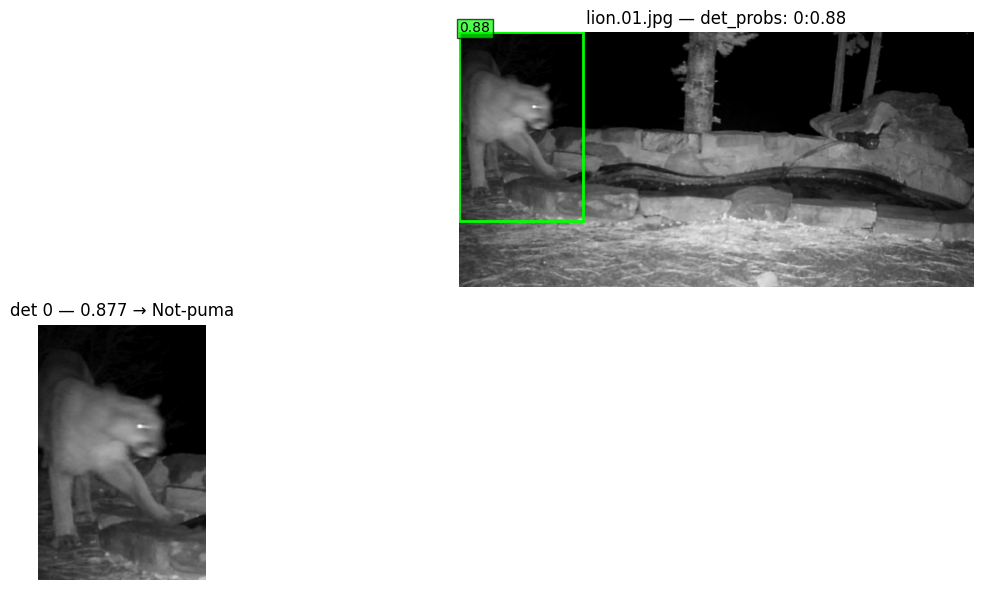

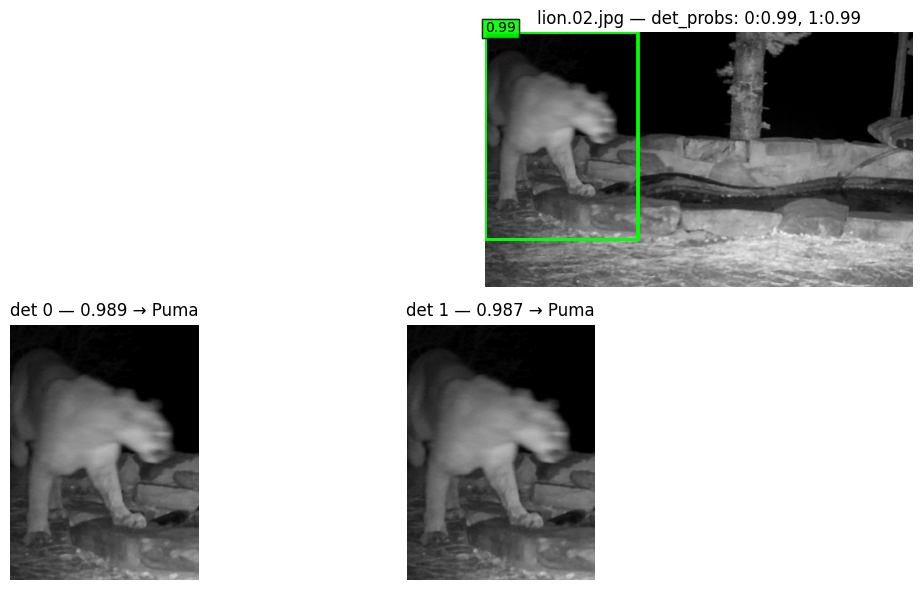

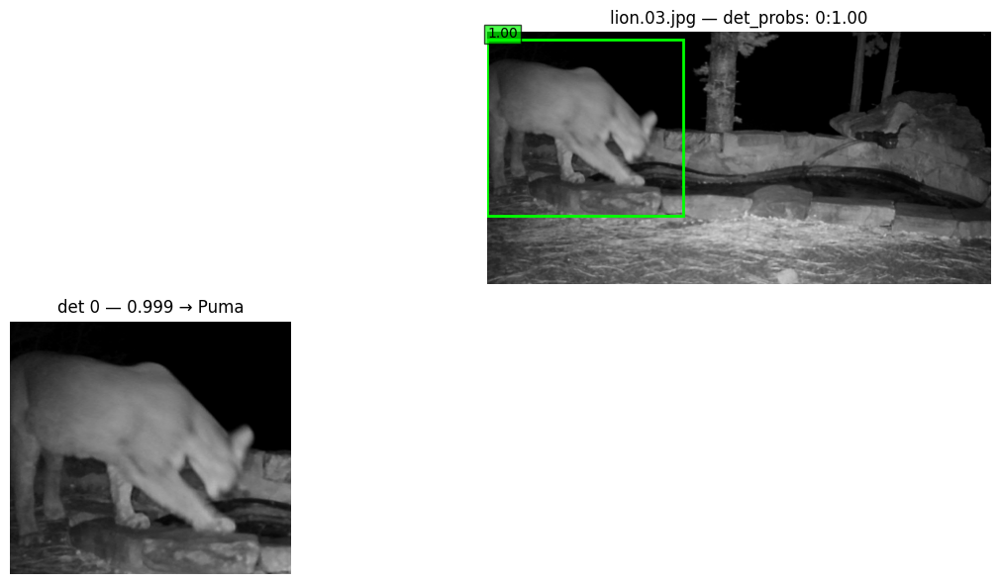

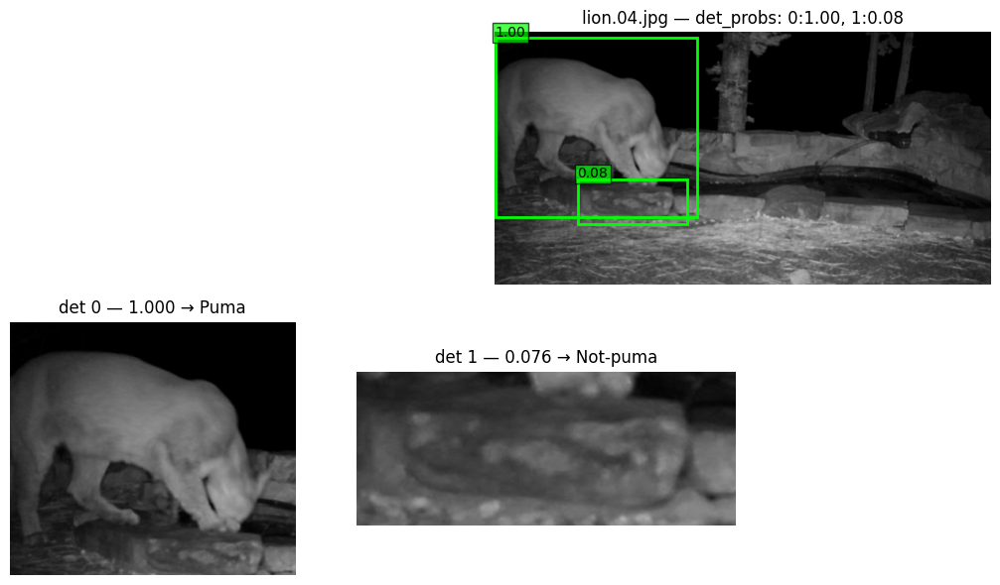

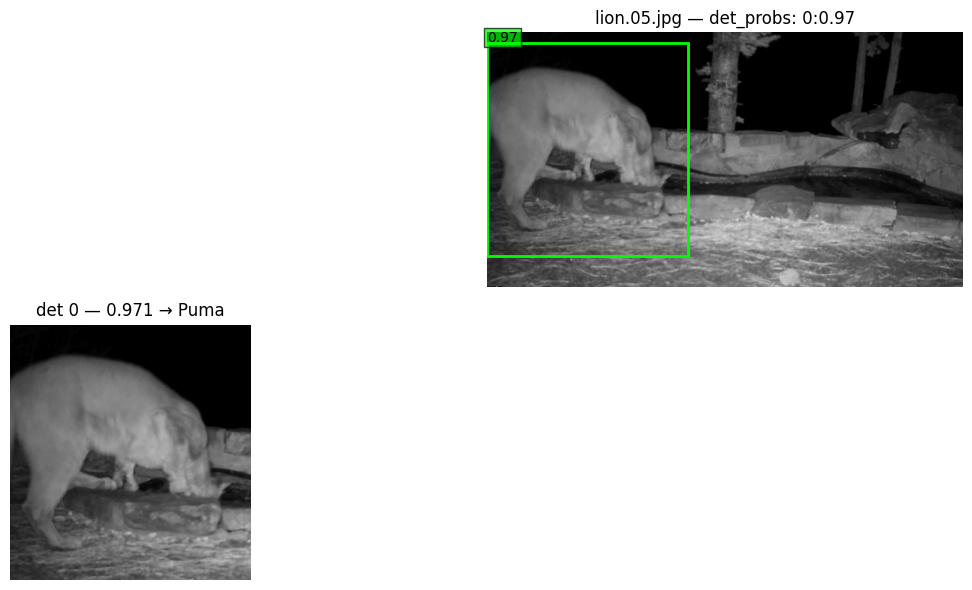

...

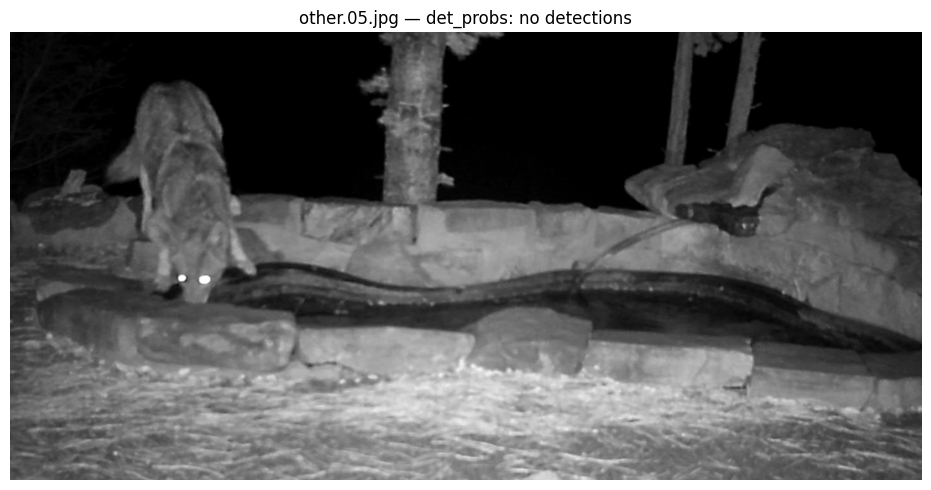

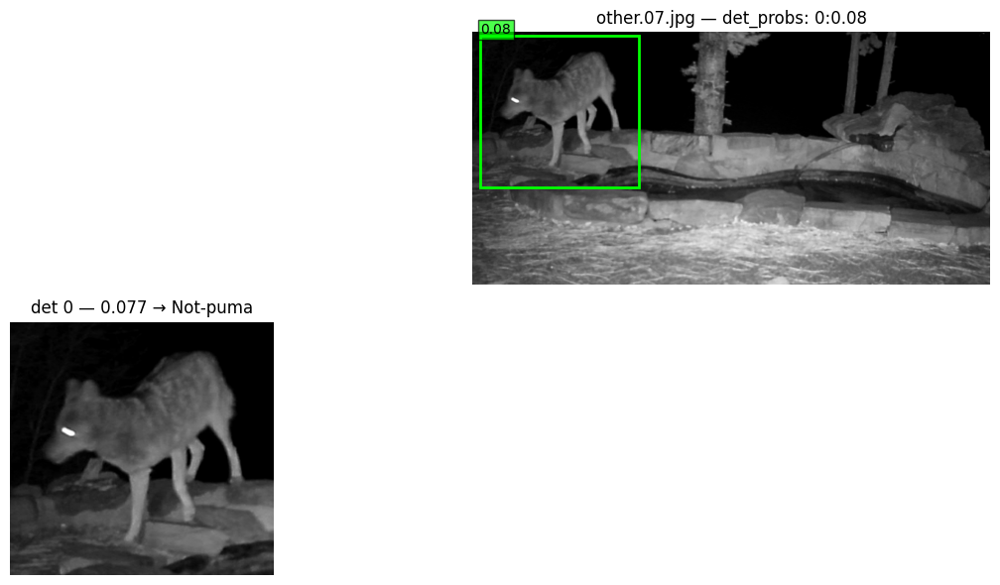

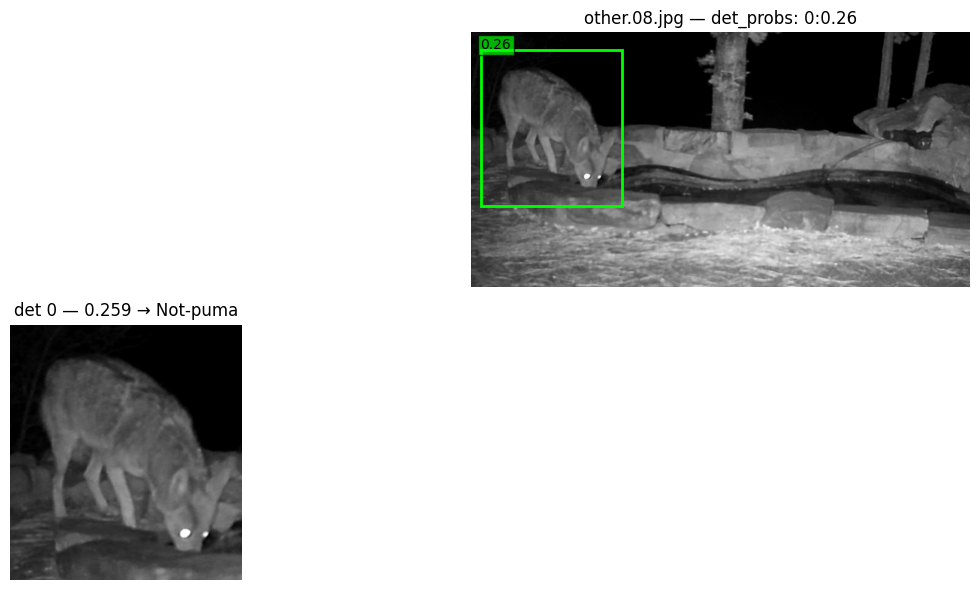

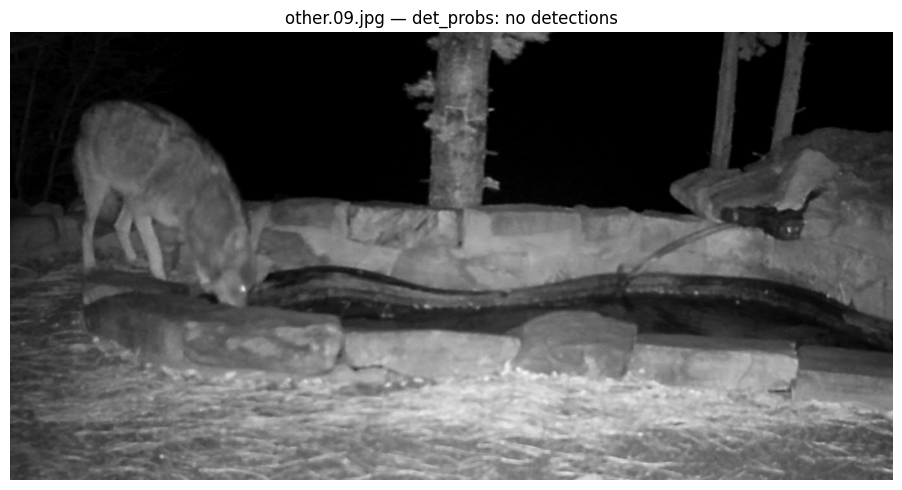

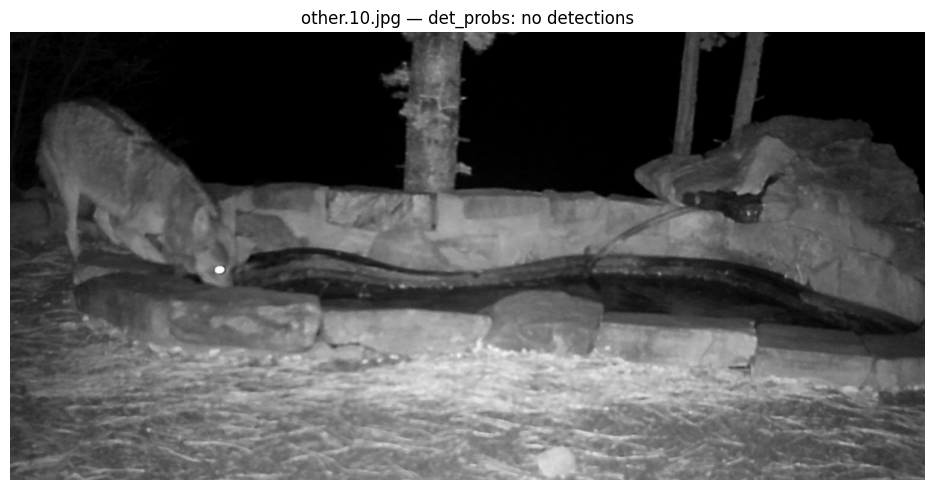

Saved detection-level and image-level CSVs, and visualizations to: puma_two_stage_work/eval/test_viz


In [14]:
## Cell D — Two-stage TEST inference with visualizations
# Set your test directory of images:
TEST_DIR = Path("/kaggle/input/testlion06/testlion06/")  # <-- EDIT this path
assert 'best_t' in globals(), "Run Cell C first to compute best_t."
assert (MODEL_DIR / "puma_cls_efficientnetv2s.h5").exists(), "Model file missing; run Cell C to save model."

from ultralytics import YOLO
from PIL import Image
from tensorflow.keras.applications import efficientnet_v2

TEST_OUT_DIR = EVAL_DIR / "test_viz"
TEST_OUT_DIR.mkdir(parents=True, exist_ok=True)

detector = YOLO(detector_weights)
clf = tf.keras.models.load_model(MODEL_DIR / "puma_cls_efficientnetv2s.h5")

def prob_puma_from_crop(pil_img):
    arr = tf.keras.utils.img_to_array(pil_img.resize((IMAGE_SIZE, IMAGE_SIZE)))
    arr = tf.expand_dims(arr, 0)
    arr = efficientnet_v2.preprocess_input(arr)
    return float(clf.predict(arr, verbose=0).ravel()[0])

def expand_box(xyxy, expand, W, H):
    x1, y1, x2, y2 = xyxy
    w, h = x2 - x1, y2 - y1
    dx, dy = w * CROP_EXPAND, h * CROP_EXPAND
    return [max(0, int(x1 - dx)), max(0, int(y1 - dy)),
            min(W - 1, int(x2 + dx)), min(H - 1, int(y2 + dy))]

all_rows, image_summary = [], []
img_paths = sorted([p for p in TEST_DIR.iterdir()
                    if p.suffix.lower() in {".jpg", ".jpeg", ".png", ".bmp", ".gif"}])
print(f"Found {len(img_paths)} test images.")

for fp in img_paths:
    im = Image.open(fp).convert("RGB")
    W, H = im.size

    # YOLO detection
    res = detector.predict(str(fp), imgsz=640, conf=CONF_THRESH,
                           iou=IOU_THRESH, max_det=MAX_DETS, verbose=False)
    boxes = (res[0].boxes.xyxy.cpu().numpy()
             if res and res[0].boxes is not None and res[0].boxes.xyxy is not None
             else [])

    det_probs, crops_xyxy, crops_imgs = [], [], []
    for j, (x1, y1, x2, y2) in enumerate(boxes):
        x1e, y1e, x2e, y2e = expand_box([x1, y1, x2, y2], CROP_EXPAND, W, H)
        crop = im.crop((x1e, y1e, x2e, y2e))
        p = prob_puma_from_crop(crop)
        det_probs.append(p)
        crops_xyxy.append((x1e, y1e, x2e, y2e))
        crops_imgs.append(crop)
        all_rows.append({
            "file": fp.name,
            "det_id": j,
            "x1": x1e, "y1": y1e, "x2": x2e, "y2": y2e,
            "prob_puma": p,
            "pred_label": "Puma" if p >= best_t else "Not-puma"
        })

    # Visualization: original with boxes + crops grid
    rows = 1 + ((len(crops_imgs) + 3) // 4)  # 1 row for original, rest for crops
    fig = plt.figure(figsize=(max(8, min(16, 4 * 4)), max(5, 3 * rows)))

    # Original image with boxes
    ax = fig.add_subplot(rows, 1, 1)
    ax.imshow(im)
    ax.axis("off")
    for p, (x1e, y1e, x2e, y2e) in zip(det_probs, crops_xyxy):
        rect = plt.Rectangle((x1e, y1e), x2e - x1e, y2e - y1e,
                             fill=False, color='lime', linewidth=2)
        ax.add_patch(rect)
        ax.text(x1e, max(0, y1e - 5), f"{p:.2f}",
                color='black',
                bbox=dict(facecolor='lime', alpha=0.7, pad=2))
    title_probs = (", ".join(f"{i}:{p:.2f}" for i, p in enumerate(det_probs))
                   if det_probs else "no detections")
    ax.set_title(f"{fp.name} — det_probs: {title_probs}")

    # Crops grid
    idx = 0
    for r in range(1, rows):
        for c in range(1, 5):
            if idx >= len(crops_imgs):
                break
            axc = fig.add_subplot(rows, 4, r * 4 + c)
            axc.imshow(crops_imgs[idx])
            axc.axis("off")
            label = "Puma" if det_probs[idx] >= best_t else "Not-puma"
            axc.set_title(f"det {idx} — {det_probs[idx]:.3f} → {label}")
            idx += 1

    out_png = TEST_OUT_DIR / f"{fp.stem}_viz.png"
    plt.tight_layout()
    plt.savefig(out_png, dpi=160)
    plt.show()

    # Image-level summary
    if det_probs:
        image_summary.append({
            "file": fp.name,
            "num_dets": len(det_probs),
            "mean_prob": float(np.mean(det_probs)),
            "max_prob": float(np.max(det_probs)),
            "agg_label_mean": "Puma" if np.mean(det_probs) >= best_t else "Not-puma",
            "agg_label_max":  "Puma" if np.max(det_probs)  >= best_t else "Not-puma",
            "viz_path": str(out_png)
        })
    else:
        image_summary.append({
            "file": fp.name,
            "num_dets": 0,
            "mean_prob": 0.0,
            "max_prob": 0.0,
            "agg_label_mean": "Not-puma",
            "agg_label_max":  "Not-puma",
            "viz_path": str(out_png)
        })

# Save CSV outputs
pd.DataFrame(all_rows).to_csv(EVAL_DIR / "test_detections_predictions.csv", index=False)
pd.DataFrame(image_summary).to_csv(EVAL_DIR / "test_image_summary.csv", index=False)
print("Saved detection-level and image-level CSVs, and visualizations to:", TEST_OUT_DIR)
